In [2]:
from IPython.display import Image
import matplotlib.pyplot as plt

# [Albumentations](https://github.com/albumentations-team/albumentations#pixel-level-transforms)

In [2]:
import albumentations as A
from albumentations.pytorch import ToTensorV2
import cv2

# Трансформации без изменения положения

# [AdditiveNoise](https://explore.albumentations.ai/transform/AdditiveNoise)

Добавляет к каждому пикселю случайное значение шума в соответствии с выбранным распределением.

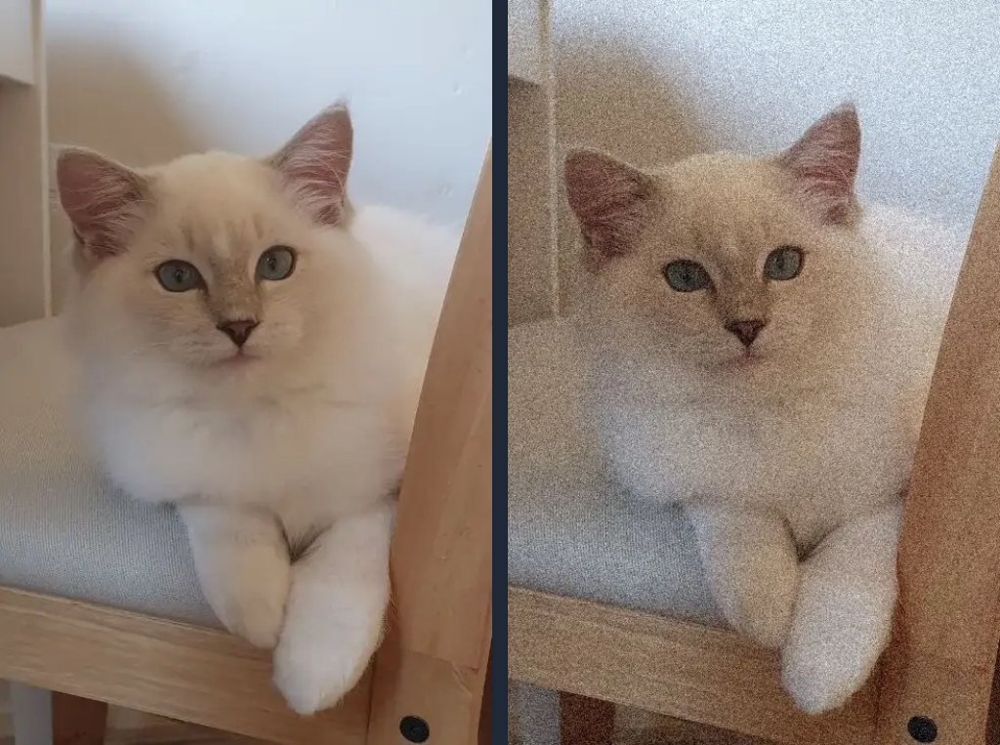

In [3]:
Image("datasets/images/AdditiveNoise.png", width="60%")

**class [AdditiveNoise](https://albumentations.ai/docs/api_reference/augmentations/transforms/#:~:text=class%20AdditiveNoise) (noise_type = 'uniform', spatial_mode = 'constant', noise_params = None, approximation = 1.0, p = 0.5)**

**noise_type** - распределение, которое будет использоваться для генерации шума. **('uniform', 'gaussian', 'laplace', 'beta')**

**spatial_mode** - параметр, который задаёт, как распределяется шум по изображению.

- **constant** - один шумовой коэффициент генерируется на канал и применяется ко всему изображению одинаково. Самый быстрый. $\newline$

- **shared** - создаётся одно общее шумовое изображение, которое применяется ко всем каналам одновременно. Для одного пикселя (независимо от канала) одно и то же значение шума.$\newline$

- **per_pixel** - для каждого пикселя и канала генерируется собственное случайное значение шума. Максимально случайный.

**approximation** - определяет компромисс между качеством сгенерированного шума и скоростью его генерации. Значения принимает в диапазоне [0, 1]. Например, для значения 0.5: шум генерируется в разрешении, уменьшенном в два раза (то есть половина исходного), а затем масштабируется обратно до полного разрешения изображения.

**noise_params** - задаются конкретные настройки распределения шума. Например, для **noise_type = 'uniform'** **{ranges: [(-0.1, 0.1), (-0.2, 0.2), (-0.1, 0.1)]}** (для красного, зелёного и синего каналов будут заданы разные диапазоны). Для **noise_type = 'gaussian'**: **{"mean_range": [0, 0], "std_range": [0.1, 0.15]}** (случайно выбираются значения из диапазона).

**p** - вероятность применения трансформации.

# [ISONoise](https://explore.albumentations.ai/transform/ISONoise)

Имитирует шум, характерный для изображений, снятых на камеру при высоких значениях **ISO**. 

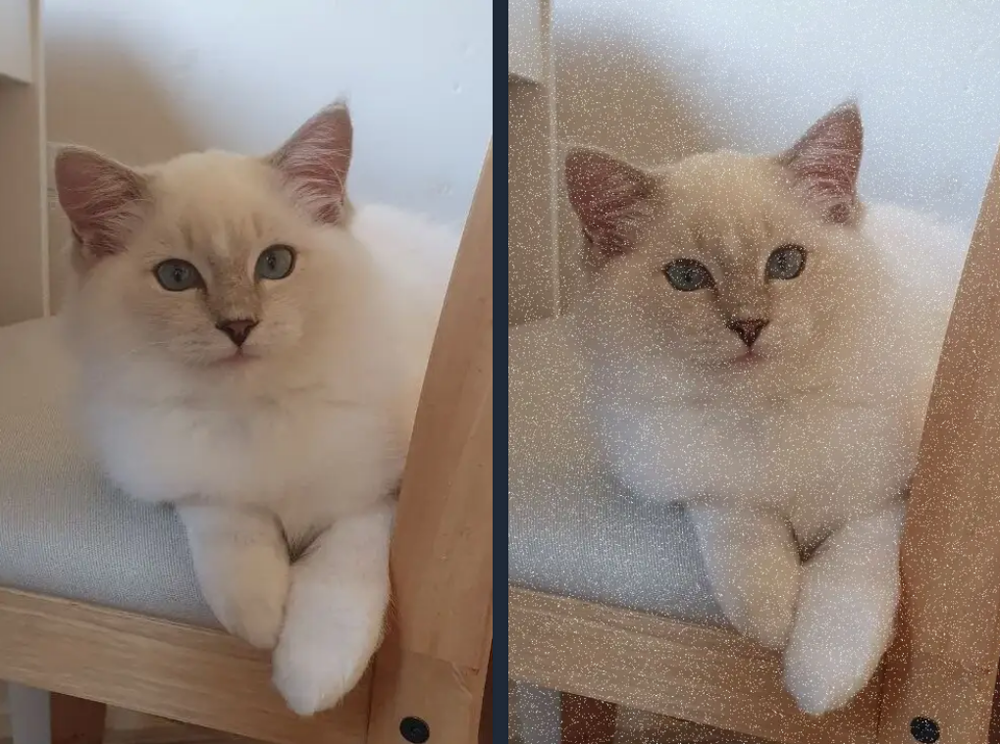

In [6]:
Image("datasets/images/ISONoise.png", width="60%")

**class [ISONoise](https://albumentations.ai/docs/api_reference/augmentations/transforms/#:~:text=class%20ISONoise) (color_shift = (0.01, 0.05), intensity = (0.1, 0.5), p = 0.5)**

**color_shift** - диапазон изменения оттенка цвета. Диапазон значений: $[0, 1]$.

**intensity** - определяет интенсивность добавляемого шума как по яркости, так и по цвету. Чем выше значение, тем больше точек.

**p** - вероятность применения трансформации.

# [MultiplicativeNoise](https://explore.albumentations.ai/transform/MultiplicativeNoise)

Умножает каждый пиксель изображения на случайное значение, взятое из некого диапазона.

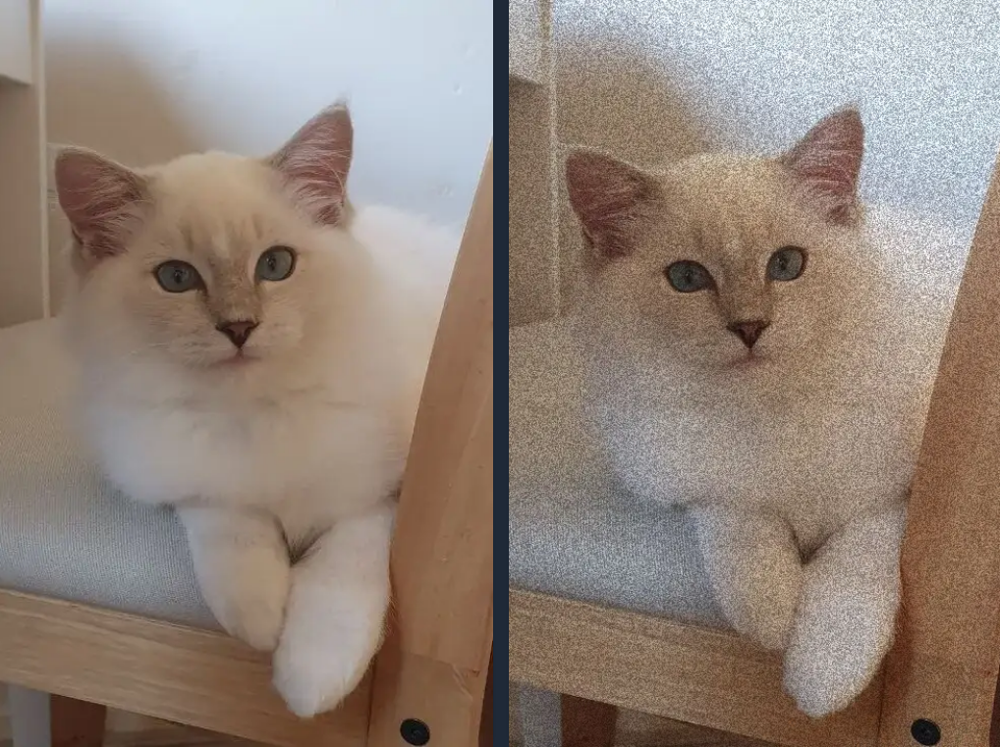

In [5]:
Image("datasets/images/MultiplicativeNoise.png", width="60%")

**class [MultiplicativeNoise](https://albumentations.ai/docs/api_reference/augmentations/transforms/#:~:text=class%20MultiplicativeNoise) (multiplier = (0.9, 1.1), per_channel = False, elementwise = False, p = 0.5)**

**multiplier** - определяет диапазон, из которого выбирается множитель.

**per_channel** - если **True**, использовать другие случайные множители для каждого канала. Если **False**, использовать один и тот же набор множителей для всех каналов.

**elementwise** - если **True**, генерирует уникальный множитель для каждого пикселя. Если **False**, генерирует один множитель для каждого пикселя.

**p** - вероятность применения трансформации.

# [CLAHE](https://explore.albumentations.ai/transform/CLAHE)

Метод улучшения контрастности изображения. Происходит как бы «растягивание» яркости всех пикселей так, чтобы самые тёмные стали ближе к чёрному, а самые светлые — к белому, но применяется это не ко всему изображению сразу, а только к небольшим областям (плиткам) изображения. Этот метод предотвращает чрезмерное усиление контрастности в областях с изначально низким контрастом.

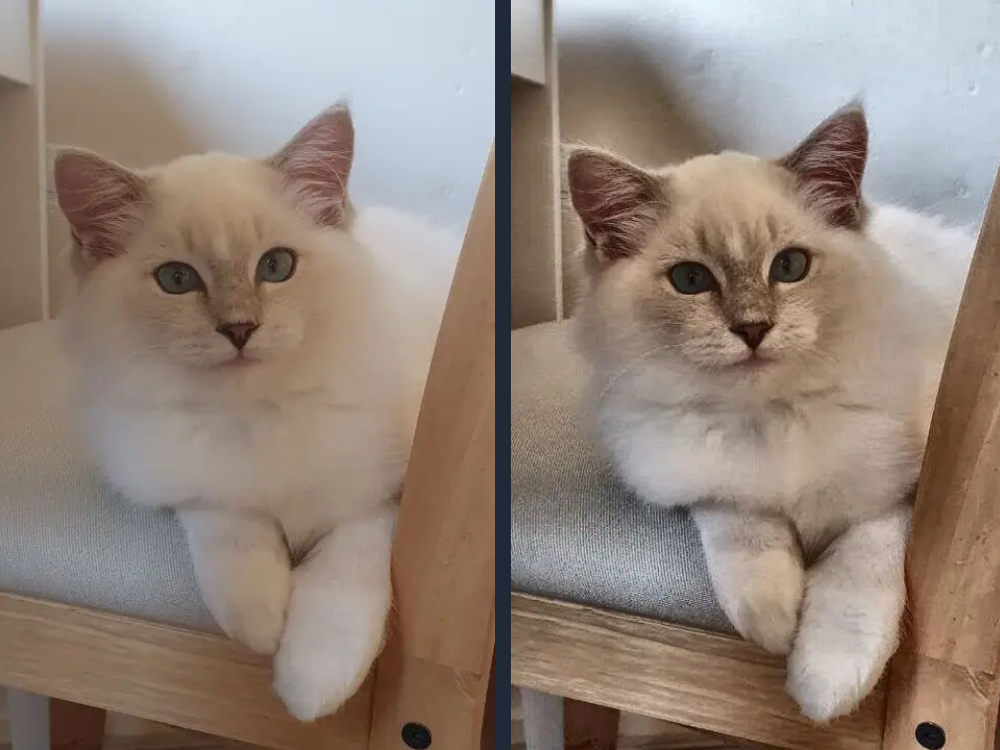

In [7]:
Image("datasets/images/CLAHE.png", width="60%")

**class [CLAHE](https://albumentations.ai/docs/api_reference/augmentations/transforms/#:~:text=class%20CLAHE) (clip_limit = 4.0, tile_grid_size = (8, 8), p = 0.5)**

**clip_limit** - контролирует, насколько сильно можно усиливать контраст. Если передать кортеж, например, **(1.0, 4.0)**, то при каждом применении будет случайно выбираться значение из этого диапазона. 

**tile_grid_size** - определяет количество плиток в направлениях строк и столбцов. Меньшие размеры плиток могут привести к более локализованным улучшениям, в то время как большие размеры дают результаты, более близкие к глобальному выравниванию гистограммы. 

**p** - вероятность применения трансформации.

# [Blur](https://explore.albumentations.ai/transform/Blur)

Добавляет равномерное размытие к изображению. 

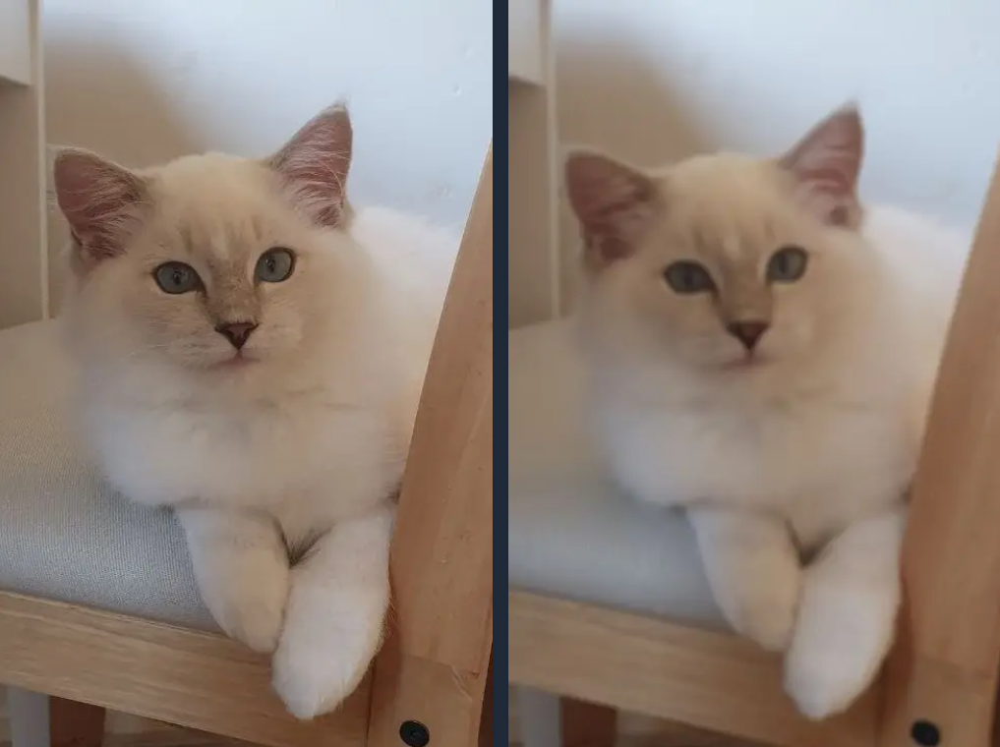

In [9]:
Image("datasets/images/Blur.png", width="60%")

**class Blur (blur_limit, p)**

**blur_limit** - определяет диапазон размеров ядра размытия. Значения - нечетные числа. Например, blur_limit = (3, 7).

**p** - вероятность применения трансформации.

# [GlassBlur](https://explore.albumentations.ai/transform/GlassBlur)

Создает эффект, похожий на размытость и искажения, возникающие при просмотре изображения через неровное стекло. Как работает: Некоторые пиксели перемещаются в пределах небольшой области, что имитирует неравномерность поверхности стекла. После этого применяется размытие (обычно гауссовское), чтобы сгладить резкие переходы и усилить ощущение «разбитости» или стеклянного эффекта.

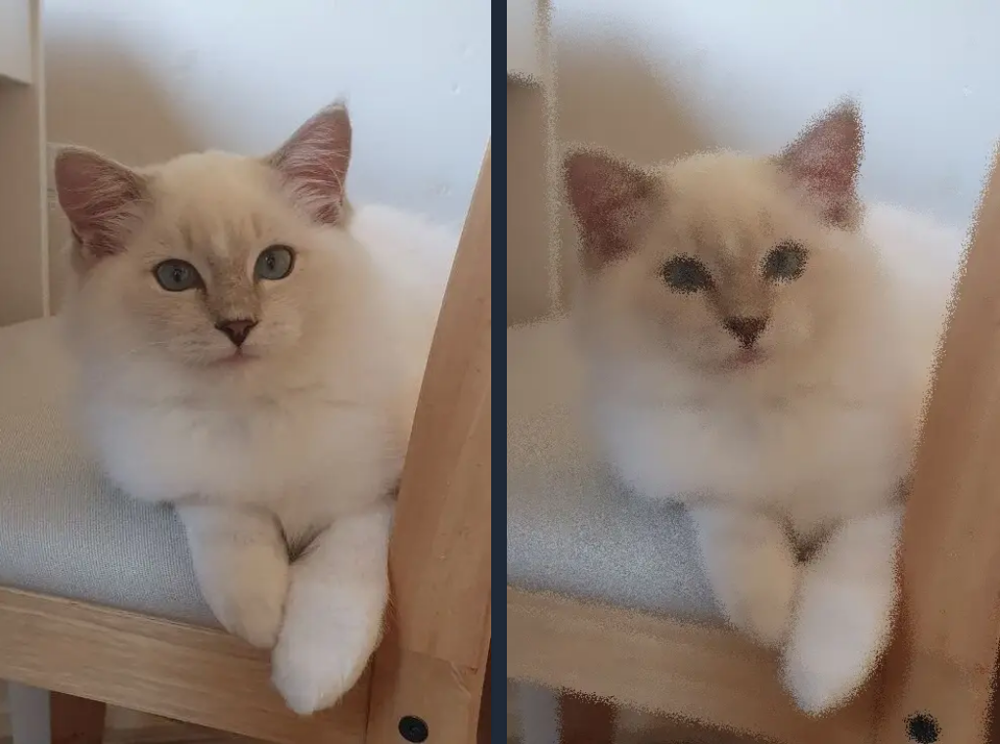

In [11]:
Image("datasets/images/GlassBlur.png", width="60%")

**class GlassBlur (sigma, max_delta, iterations)**

**sigma** - cтандартное отклонение для гауссова размытия, которое определяет, насколько сильно будет размыто изображение.

**max_delta** - максимальное смещение для случайного перемещения пикселей, то есть насколько далеко пиксель может «отойти» от исходного положения.

**iterations** - количество итераций перемешивания, что влияет на итоговую интенсивность искажения.

**p** - вероятность применения трансформации.

# [MotionBlur](https://explore.albumentations.ai/transform/MotionBlur)

Имитирует размытие, вызванное движением камеры или объекта во время съёмки.

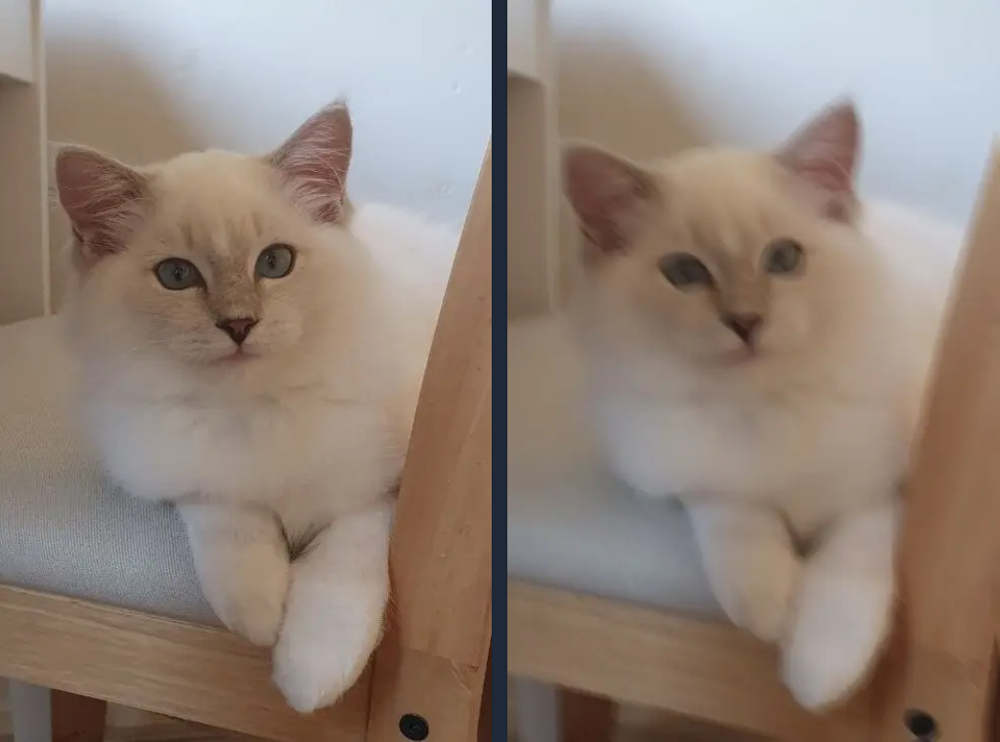

In [12]:
Image("datasets/images/MotionBlur.png", width="60%")

**class MotionBlur (blur_limit = (3, 7), allow_shifted = True, angle_range = (0.0, 360.0), direction_range = (-1.0, 1.0), p = 0.5)**

**blur_limit** - определяет диапазон размеров ядра размытия. Значения - нечетные числа. Например, blur_limit = (3, 7).

**allow_shifted** - размытие применяется со случайным сдвигом, что делает эффект более естественным.

**angle_range** - задаёт диапазон углов (в градусах). Управляет поворотом линии размытия в движении. Например, 90° - размытие вертикального движения.

**direction_range** - управляет тем, в какую сторону распространяется эффект размытия относительно направления движения. -1 - размытие распространяется только в "обратном" направлении (за движущимся объектом). 0 - размытие симметрично относительно центра, то есть эффект распространяется одинаково в обоих направлениях. 1 - размытие распространяется только в "прямом" направлении.

**p** - вероятность применения трансформации.

# [MedianBlur](https://explore.albumentations.ai/transform/MedianBlur)

Реализует медианный фильтр для размытия изображения (для каждого пикселя выбирается значение медианы из окрестности). 

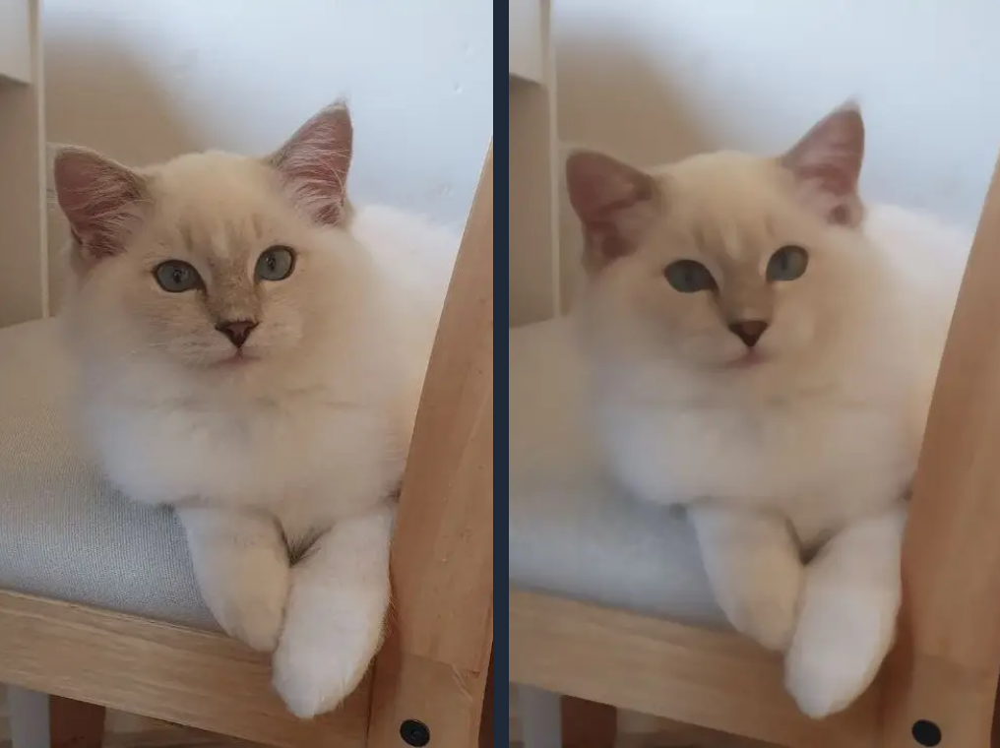

In [14]:
Image("datasets/images/MedianBlur.png", width="60%")

**class MedianBlur (blur_limit, p)**

**blur_limit** - определяет диапазон размеров ядра размытия. Значения - нечетные числа. Например, blur_limit = (3, 7)

**p** - вероятность применения трансформации.

# [ColorJitter](https://explore.albumentations.ai/transform/ColorJitter)

Случайным образом изменяет яркость, контрастность, насыщенность и оттенок изображения.

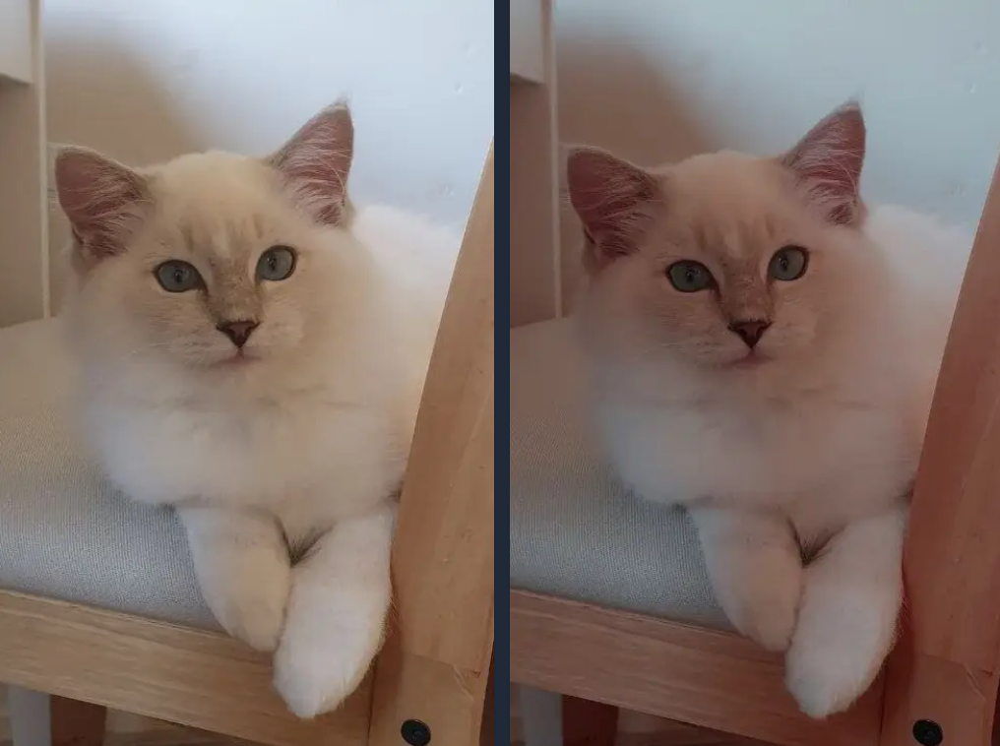

In [15]:
Image("datasets/images/ColorJitter.png", width="60%")

**class [ColorJitter](https://albumentations.ai/docs/api_reference/augmentations/transforms/#:~:text=class%20ColorJitter) (brightness = (0.8, 1.2), contrast = (0.8, 1.2), saturation = (0.8, 1.2), hue = (-0.5, 0.5), p = 0.5)**

**brightness** - яркость: делает изображение темнее или светлее. $(0.8, 1.2) → \pm\,20\%$

**contrast** - контраст: увеличивает/уменьшает разницу между тёмными и светлыми участками. $(0.7, 1.3) → ±\,30\%$

**saturation** - насыщенность: изменяет интенсивность цветов. $(0.5, 1.5) → ±\,50\%$

**hue** - оттенок: смещает цвета по спектру (например, зелёный → бирюзовый). Диапазон значений: $0 ≤ hue ≤ 0.5$ если значение - **float**. Если кортеж - диапазон $[-0.5, 0.5]$.

**p** - вероятность применения трансформации.

# [HueSaturationValue](https://explore.albumentations.ai/transform/HueSaturationValue)

Изменяет цвета изображения в пространстве **HSV** (оттенок, насыщенность, яркость). Причем все они (оттенок, насыщенность, яркость) меняются независимо, так как эта трансформация работает в формате **HSV**, а не **RGB**. Например, **ColorJitter** при увеличении яркости может неявно изменить насыщенность. **HueSaturationValue** не меняет контрастность.

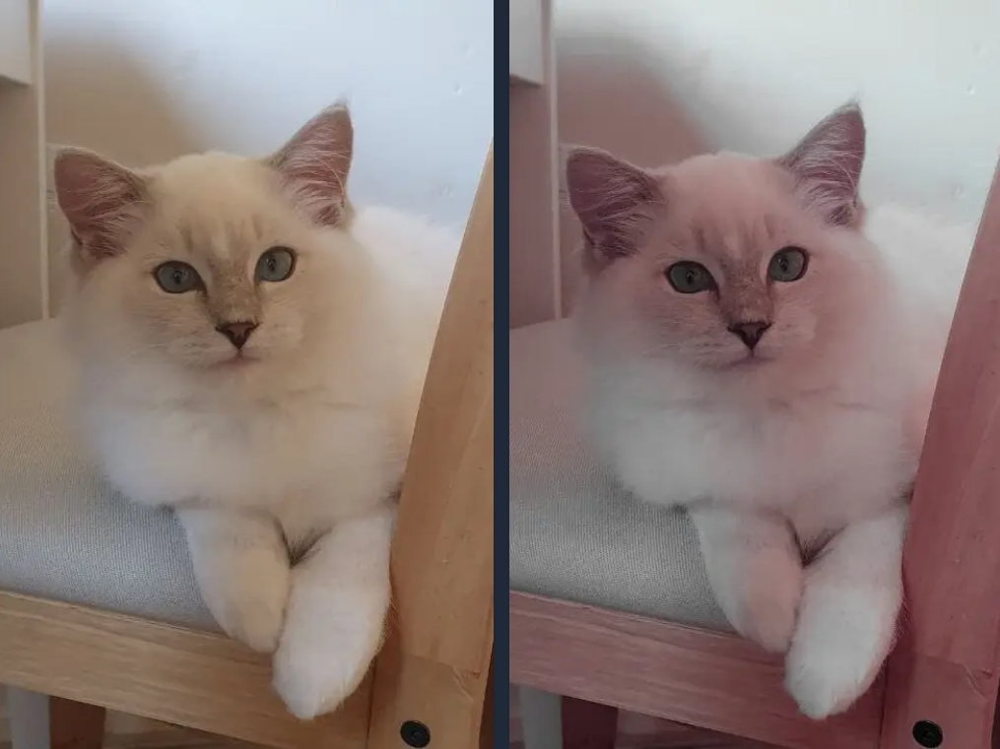

In [16]:
Image("datasets/images/HueSaturationValue.png", width="60%")

**class [HueSaturationValue](https://albumentations.ai/docs/api_reference/augmentations/transforms/#:~:text=class%20HueSaturationValue) (hue_shift_limit = (-20, 20), sat_shift_limit = (-30, 30), val_shift_limit = (-20, 20), p = 0.5)**

**hue_shift_limit** - диапазон изменения оттенка. Диапазон значений: $[-180, 180]$.

**sat_shift_limit** - диапазон изменения насыщенности. Диапазон значений: $[-255, 255]$.

**val_shift_limit** - диапазон изменения значения яркости. Диапазон значений: $[-255, 255]$.

**p** - вероятность применения трансформации.

# [PlanckianJitter](https://explore.albumentations.ai/transform/PlanckianJitter)

Изменяет цветовую температуру изображения, имитируя естественные изменения освещения в зависимости от физики излучения. Трансформация не просто случайно меняет цвета, а делает это на основе реальных законов (например, закона Планка), чтобы изображение выглядело так, как если бы его снимали при разных типах света — от теплого закатного до холодного дневного. В отличие от **ColorJitter**, который случайным образом изменяет яркость, контраст и насыщенность, **PlanckianJitter** использует реальные физические зависимости изменения цвета при изменении источника света.

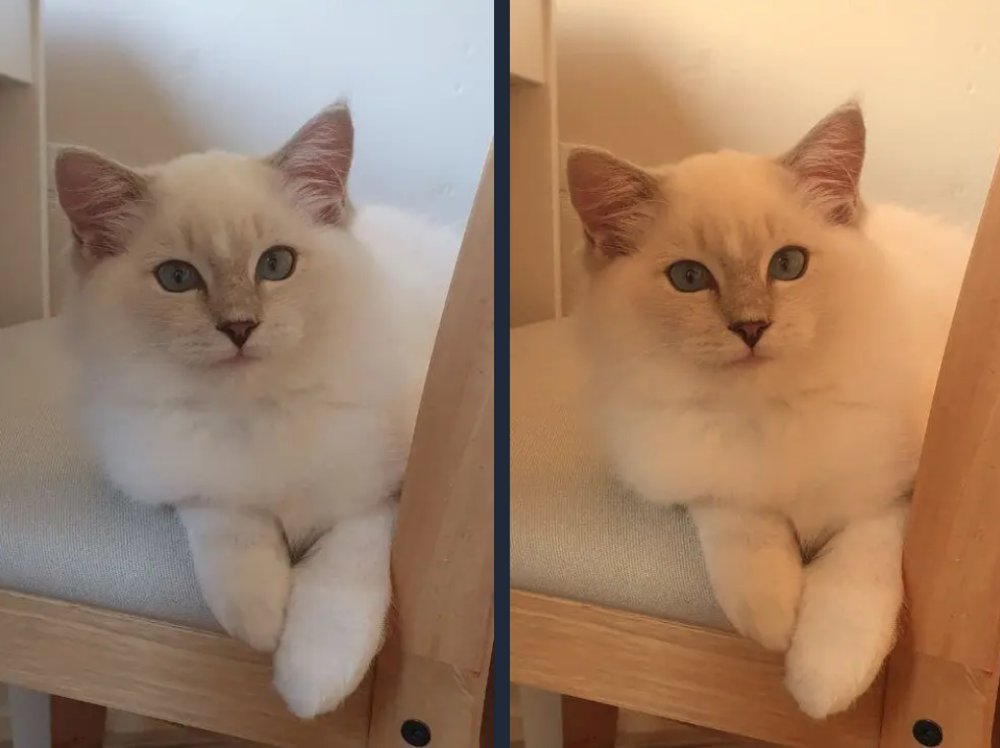

In [17]:
Image("datasets/images/PlanckianJitter.png", width="60%")

**class [PlanckianJitter](https://albumentations.ai/docs/api_reference/augmentations/transforms/#:~:text=class%20PlanckianJitter) (mode = 'blackbody', temperature_limit = None, sampling_method = 'uniform', p = 0.5)**

**mode** - выбирает физическую модель, на основе которой происходит изменение цветовой температуры изображения.

- **blackbody** - используется модель излучения черного тела (по закону Планка). $\newline$

- **cied** - модель, основанная на стандартах дневного света (CIE D illuminants). 

**temperature_limit** - определяет диапазон температур, из которого выбирается значение для изменения цвета. Более высокие температуры дают более холодные (голубоватые) изображения, более низкие температуры дают более теплые (красноватые) изображения. Диапазон значении для **blackbody** - $[3000, 15000]$, для **cied** - $[4000, 15000]$.

**sampling_method** - определяет способ выбора температуры из заданного диапазона.

- **uniform** - температура выбирается из равномерного распределения. $\newline$

- **gaussian** - выборка из гауссовского распределения с центром в 6500K (приблизительно дневной свет).

**p** - вероятность применения трансформации.

# [Illumination](https://explore.albumentations.ai/transform/Illumination)

Позволяет добавлять к изображению различные эффекты освещения, как будто меняется источник света или его интенсивность. Есть предположение, что только **mode = gaussian** работает правильно (в других **effect_type** странно работает), поэтому лучше использовать только его.

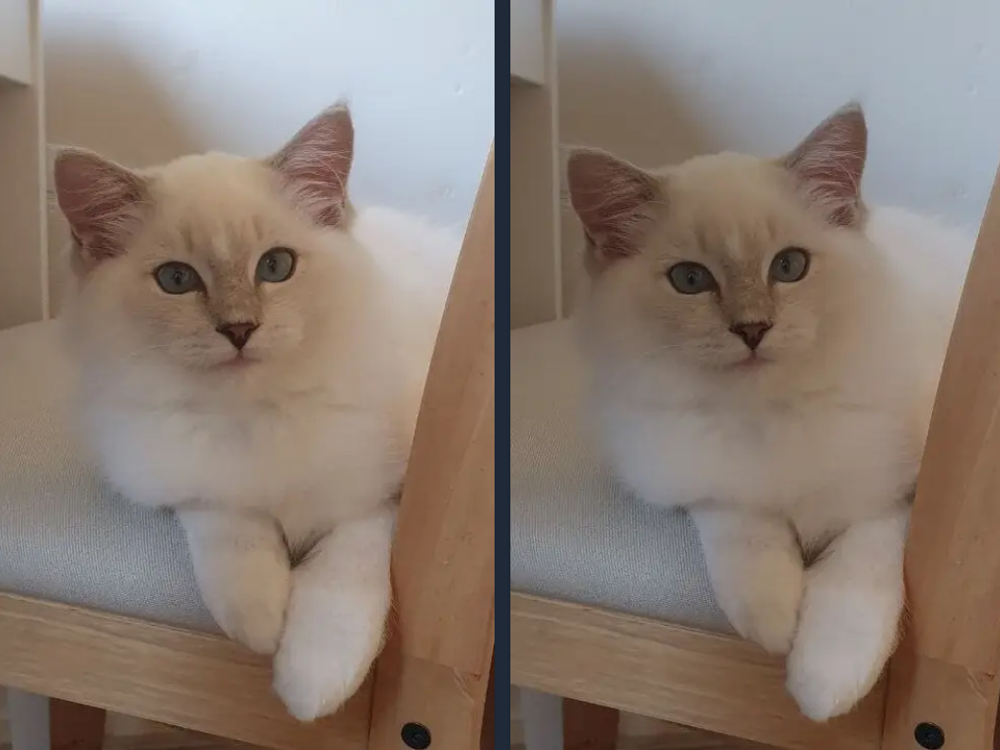

In [18]:
Image("datasets/images/Illumination.png", width="60%")

**class [Illumination](https://albumentations.ai/docs/api_reference/augmentations/transforms/#:~:text=class%20Illumination) (mode, intensity_range, effect_type, angle_range, center_range, sigma_range, p)**

**mode** - тип освещения.

- **linear** — плавный градиент (как солнечный свет через окно). $\newline$

- **corner** — свет/тень из угла (например, лампа в углу комнаты). $\newline$

- **gaussian** — круговое пятно (как прожектор или фонарик). 

**intensity_range** - задает диапазон интенсивности эффекта. Диапазон значений: $[0.01, 0.2]$

- $0.01–0.05$ — едва заметные изменения.$\newline$

- $0.05–0.1$ — заметное освещение.$\newline$

- $0.1–0.2$ - cильный эффект освещения.

**effect_type** - тип светового эффекта.

- **brighten** – только осветление (как прожектор).$\newline$

- **darken** – только затемнение (как отбрасывание тени).$\newline$

- **both** – случайным образом выбирается между осветлением и затемнением.

**center_range** - диапазон для положения прожектора (только в режиме **'gaussian'**). Значения от 0 до 1, где (0, 0) – верхний левый угол, (1, 1) – нижний правый, (0.5, 0.5) – центр.

**sigma_range** - диапазон размера прожектора (только в режиме **'gaussian'**). Значения от 0.2 до 1. Низкие значения (например, 0.2) дают узкий, сфокусированный световой круг. Более высокие значения (например, 1.0) – создают широкий, мягкий световой эффект.

**p** - вероятность применения трансформации.

# [ImageCompression](https://explore.albumentations.ai/transform/ImageCompression)

Уменьшите качество изображения, применив сжатие JPEG или WebP. Полезно для устойчивости модели к различным качествам изображения.

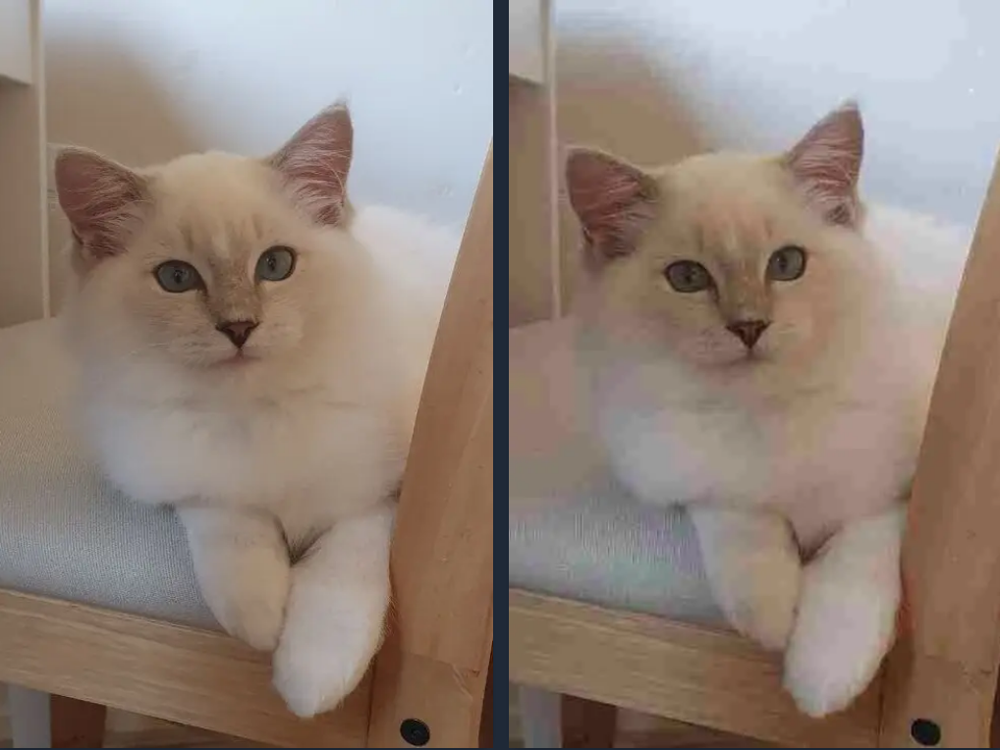

In [19]:
Image("datasets/images/ImageCompression.png", width="60%")

**class [ImageCompression](https://albumentations.ai/docs/api_reference/augmentations/transforms/#:~:text=class%20ImageCompression) (compression_type = 'jpeg', quality_range = (99, 100), p = 0.5)**

**quality_range** - диапазон качества сжатия. Диапазон значений: $[1, 100]$. (1 - максимальное сжатие, 100 - минимальное сжатие) 

**compression_type** - тип применяемого сжатия: **jpeg** и **webp**.

**p** - вероятность применения трансформации.

# [Downscale](https://explore.albumentations.ai/transform/Downscale)

Уменьшите качество изображения путем уменьшения и увеличения масштаба. Сначала масштаб изображения уменьшается до более низкого разрешения, а затем увеличивается до исходного размера. Может использоваться для имитации изображений низкого качества.

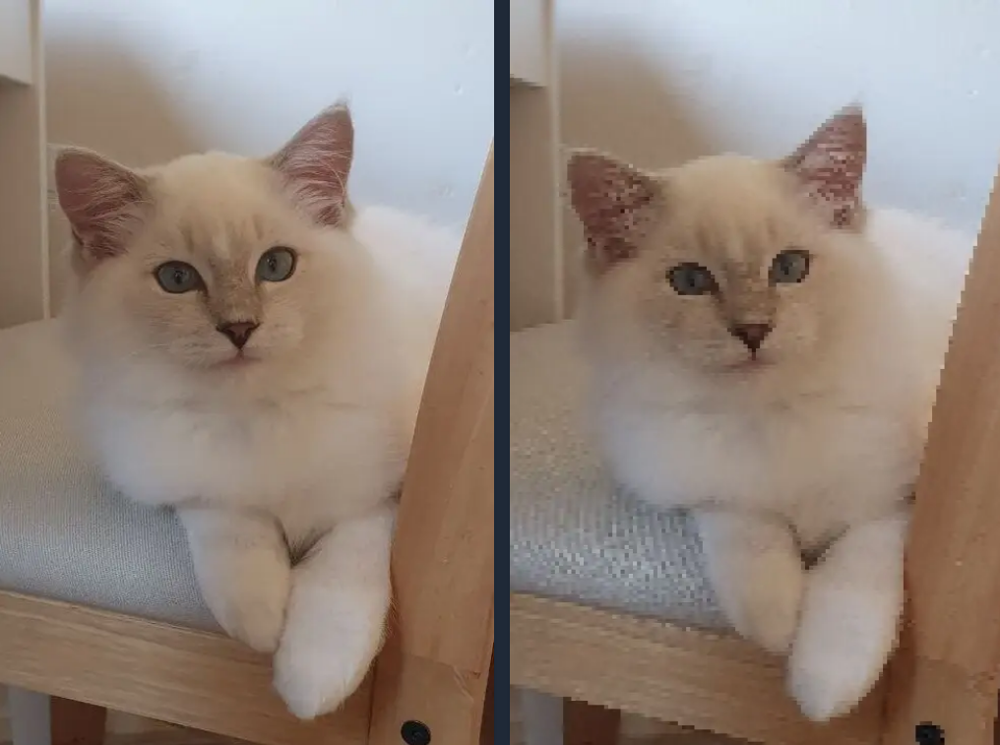

In [20]:
Image("datasets/images/Downscale.png", width="60%")

**class [Downscale](https://albumentations.ai/docs/api_reference/augmentations/transforms/#:~:text=class%20Downscale) (scale_range=(0.25, 0.25), interpolation_pair={'upscale': 0, 'downscale': 0}, p=0.5)**

**scale_range** - диапазон для коэффициента уменьшения масштаба. Более низкие значения приводят к более агрессивному уменьшению масштаба. Диапазон значений: $[0, 1]$.

**interpolation_pair** - словарь, определяющий методы интерполяции для использования при уменьшении и увеличении масштаба.

**p** - вероятность применения трансформации.

# [Posterize](https://explore.albumentations.ai/transform/Posterize)

Уменьшает количество бит для каждого цветового канала изображения. Применяет технику, которая уменьшает количество отдельных цветов, используемых в изображении.

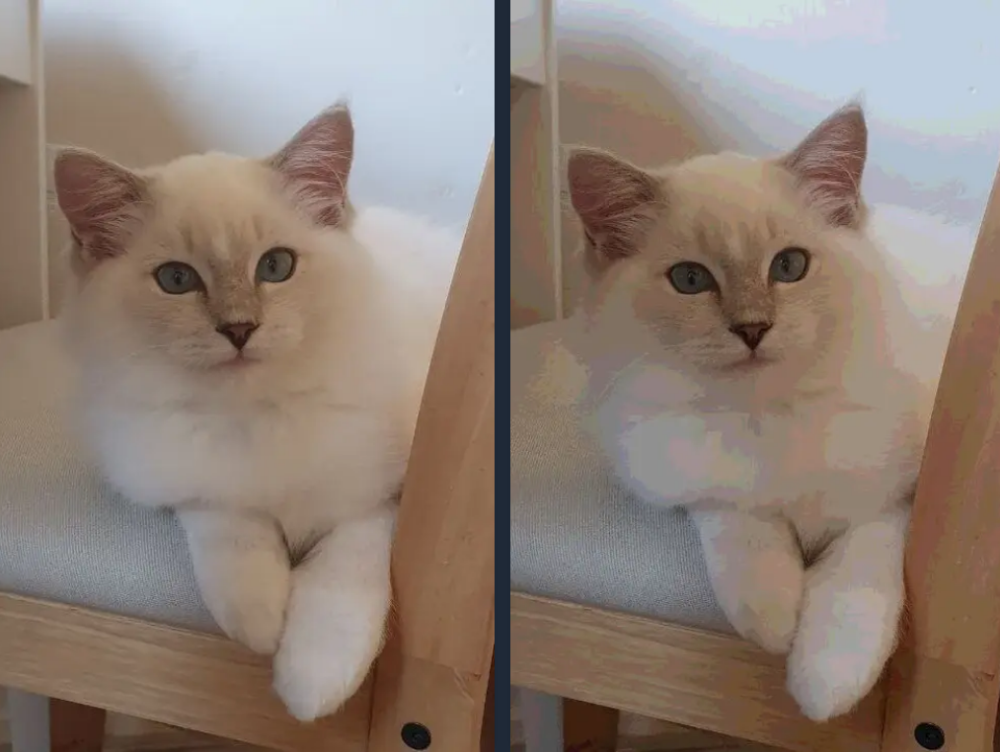

In [21]:
Image("datasets/images/Posterize.png", width="60%")

**class [Posterize](https://albumentations.ai/docs/api_reference/augmentations/transforms/#:~:text=class%20Posterize) (num_bits=4, p=0.5)**

**num_bits** - определяет количество бит, сохраняемых для каждого цветового канала. Значения: **int** или **tuple[int, int]** - диапазон. 

**p** - вероятность применения трансформации.

# [Emboss](https://explore.albumentations.ai/transform/Emboss)

Создает эффект рельефа, выделяя края и создавая 3D-эффект.

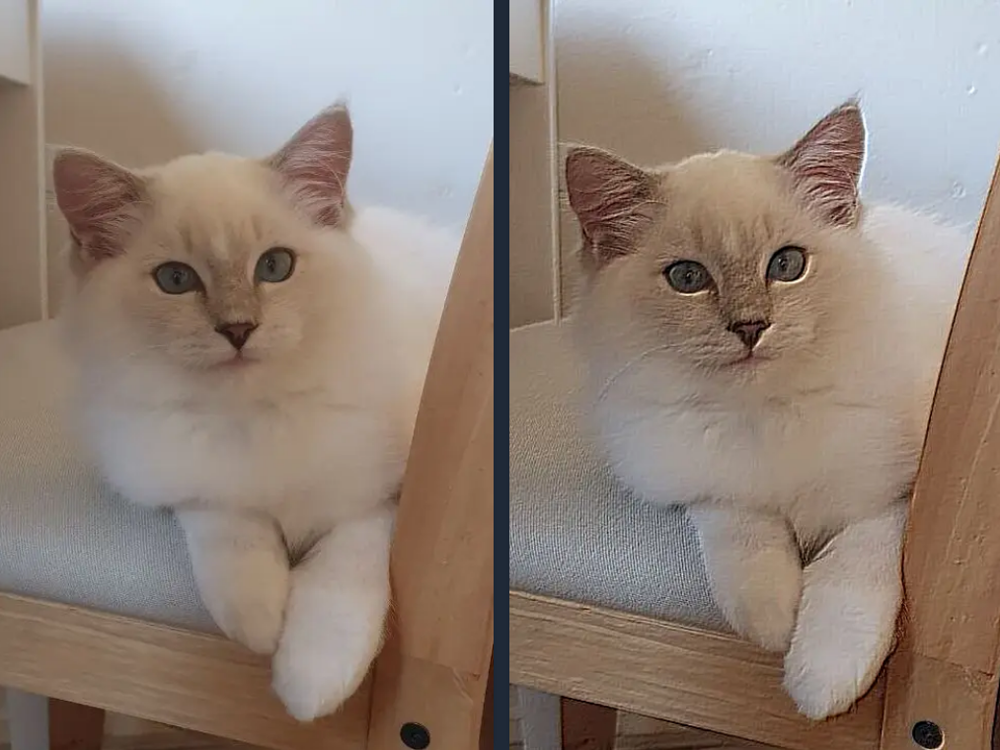

In [23]:
Image("datasets/images/Emboss.png", width="60%")

**class [Emboss](https://albumentations.ai/docs/api_reference/augmentations/transforms/#:~:text=class%20Emboss) (alpha=(0.2, 0.5), strength=(0.2, 0.7), p=0.5)**

**alpha** - контролирует, насколько сильно будет виден эффект. Диапазон значений: $[0,1]$. (0 - изображение остается неизменным, 1 - видно только эффект тиснения).

**strength** - диапазон для выбора силы эффекта тиснения. Более высокие значения создают более выраженный 3D-эффект. Значения должны быть неотрицательными.

**p** - вероятность применения трансформации.

# [RGBShift](https://explore.albumentations.ai/transform/RGBShift)

Добавляет к каждому каналу **(R, G, B)** константное число, выбранное случайным образом из указанного диапазона. Это похоже на добавление шума, но вместо того чтобы менять яркость случайно для каждого пикселя, он сдвигает все пиксели одного канала на одно и то же значение.

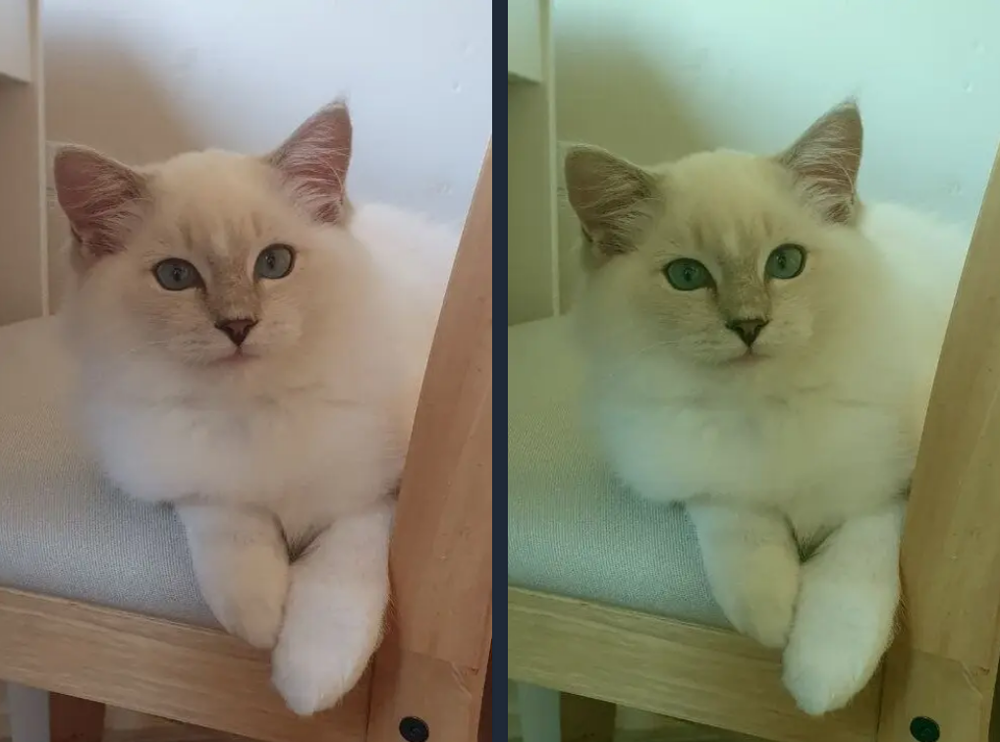

In [24]:
Image("datasets/images/RGBShift.png", width="60%")

**class [RGBShift](https://albumentations.ai/docs/api_reference/augmentations/transforms/#:~:text=class%20RGBShift) (r_shift_limit = (-20, 20), g_shift_limit = (-20, 20), b_shift_limit = (-20, 20), p = 0.5)**

**r_shift_limit** - диапазон, из которого выбирается случайное значение сдвига для красного канала. Значения представляют абсолютные смещения в диапазоне $[0, 255]$.

**g_shift_limit** - диапазон, из которого выбирается случайное значение сдвига для зеленого канала. Значения представляют абсолютные смещения в диапазоне $[0, 255]$.

**b_shift_limit** - диапазон, из которого выбирается случайное значение сдвига для синего канала. Значения представляют абсолютные смещения в диапазоне $[0, 255]$.

**p** - вероятность применения трансформации.

# [RandomGamma](https://explore.albumentations.ai/transform/RandomGamma)

Применяет нелинейную коррекцию яркости, которая сильнее влияет на средние тона изображения.

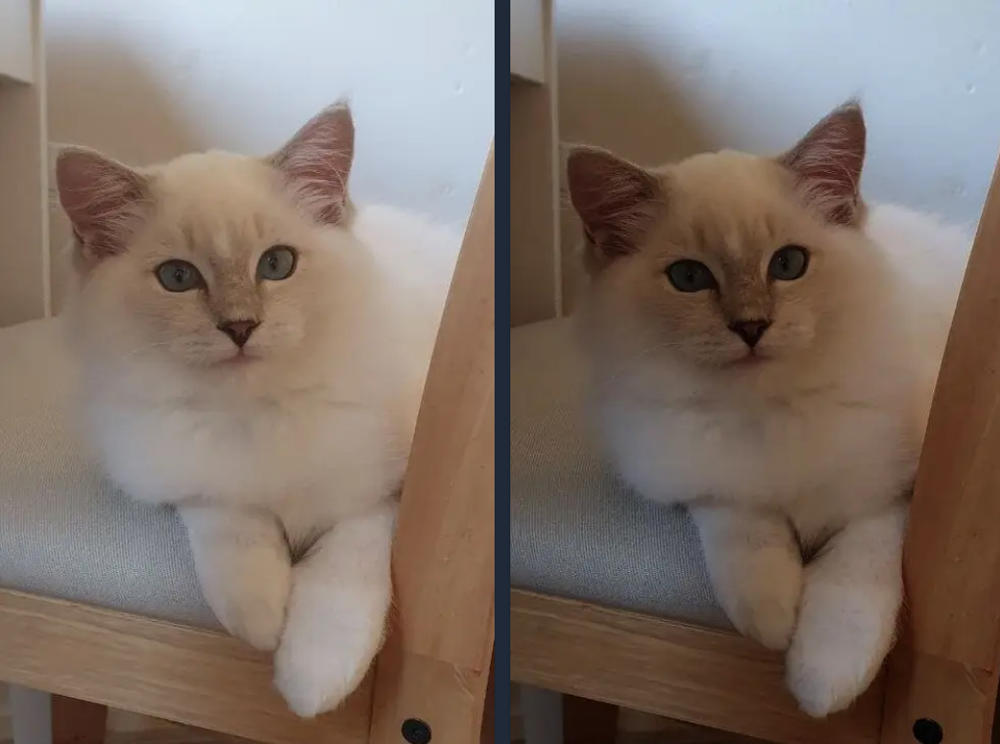

In [25]:
Image("datasets/images/RandomGamma.png", width="60%")

**class [RandomGamma](https://albumentations.ai/docs/api_reference/augmentations/transforms/#:~:text=class%20RandomGamma) (gamma_limit=(80, 120), p=0.5)**

**gamma_limit** - нижняя и верхняя границы для регулировки гаммы. Значения указываются в процентах, например, (80, 120) означает, что гамма будет находиться в диапазоне от 80% до 120% от исходного значения. 

**p** - вероятность применения трансформации.

# [RandomRain](https://explore.albumentations.ai/transform/RandomRain)

Добавляет к изображению эффекты дождя. Это преобразование имитирует дождь, накладывая полупрозрачные полосы на изображение, создавая реалистичный эффект дождя. 

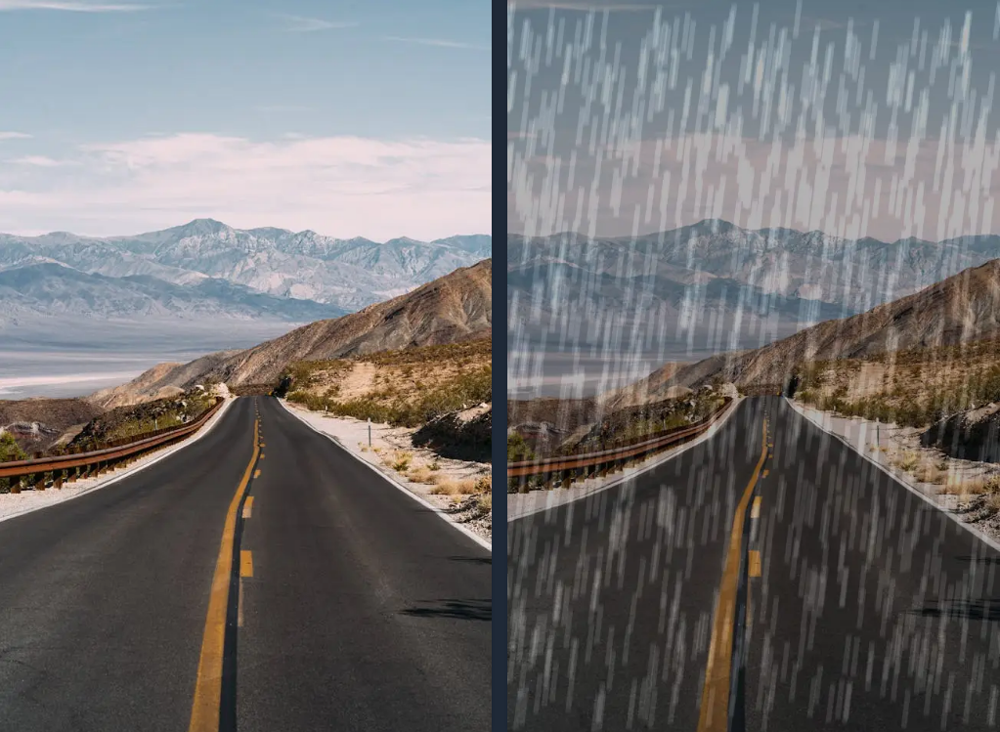

In [26]:
Image("datasets/images/RandomRain.png", width="60%")

**class [RandomRain](https://albumentations.ai/docs/api_reference/augmentations/transforms/#:~:text=class%20RandomRain) (slant_range = (-10, 10), drop_length = 20, drop_width = 1, drop_color = (200, 200, 200), blur_value = 7, brightness_coefficient = 0.7, rain_type = 'default', p = 0.5)**

**slant_range** - диапазон угла наклона дождя в градусах.

**drop_length** - длина капель дождя в пикселях.

**drop_width** - ширина капель дождя в пикселях.

**drop_color** - цвет капель дождя в формате RGB. 

**blur_value** - значение размытия для имитации эффекта дождя. Линии должны быть размыты, чтобы более точно имитировать дождь.

**brightness_coefficient** - коэффициент для регулировки яркости изображения. Дождливые сцены обычно темнее. Диапазон значений: $(0, 1]$

**rain_type** - тип дождя для имитации. 

- **drizzle** - моросящий дождь. $\newline$

- **heavy** - сильный дождь. $\newline$

- **torrential** - проливной дождь. $\newline$

- **default** - дождь по умолчанию (такой же, как **drizzle** по ощущуниям).

**p** - вероятность применения трансформации.

# [RandomSnow](https://explore.albumentations.ai/transform/RandomSnow)

Имитирует эффект снега на изображении, либо обесцвечивая некоторые значения пикселей, либо добавляя текстуру снега к изображению, в зависимости от выбранного метода.

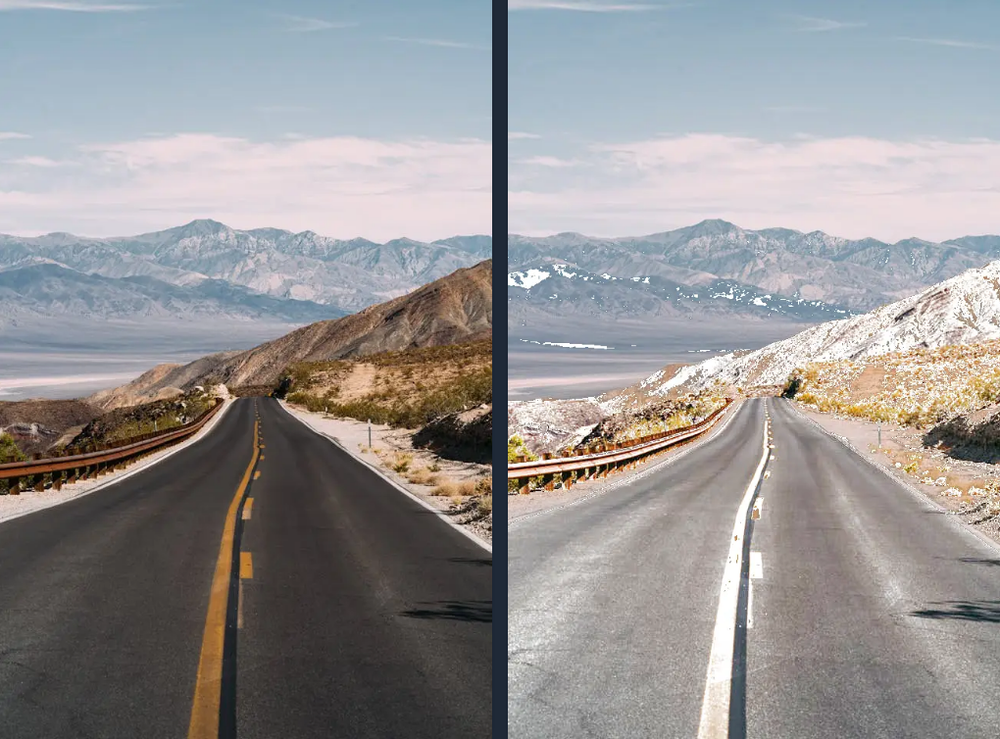

In [27]:
Image("datasets/images/RandomSnow.png", width="60%")

**class [RandomSnow](https://albumentations.ai/docs/api_reference/augmentations/transforms/#:~:text=class%20RandomSnow) (brightness_coeff = 2.5, snow_point_range = (0.1, 0.3), method = 'bleach', p = 0.5)** 

**snow_point_range** - диапазон порога точки снега (от 0 до 1). Все пиксели, у которых яркость (меняется от 0 до 1) ниже этого порога, будут умножаться на **brightness_coeff**. 

**brightness_coeff** - коэффициент, применяемый для увеличения яркости пикселей ниже порога **snow_point**.

**method** - метод имитации снега.

- **bleach** - использует технику пороговой обработки пикселей. $\newline$

- **texture** - применяет наложение текстуры снега.

**p** - вероятность применения трансформации.

# [RandomSunFlare](https://explore.albumentations.ai/transform/RandomSunFlare)

Создает эффект солнечного блика путем наложения нескольких полупрозрачных кругов разного размера и интенсивности вдоль линии, исходящей из точки "солнца".

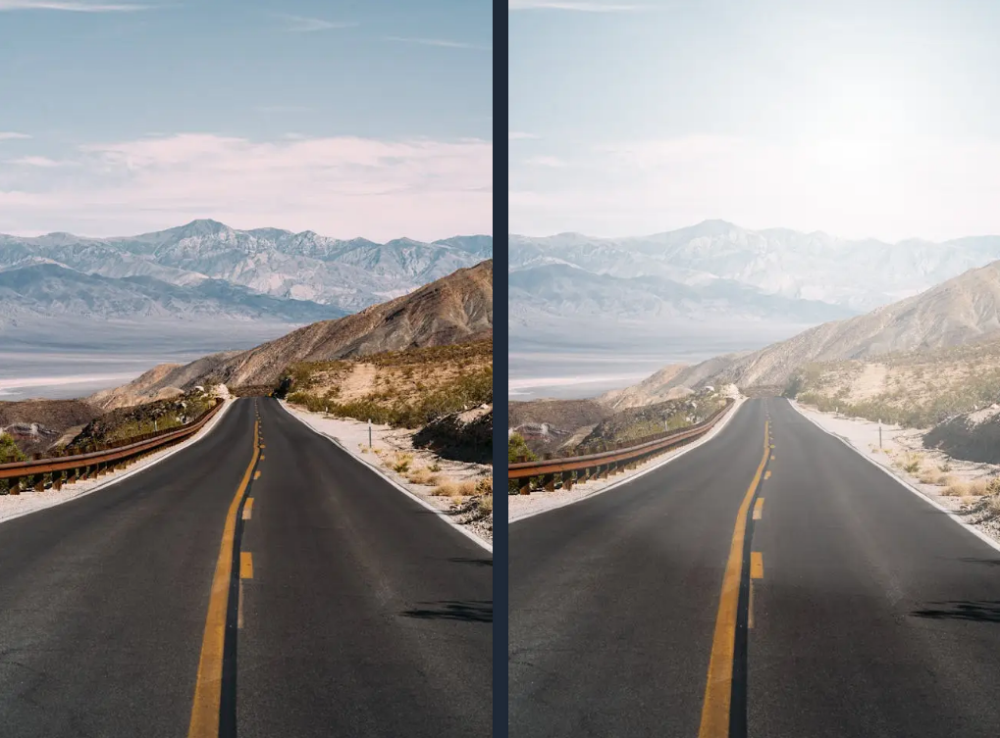

In [28]:
Image("datasets/images/RandomSunFlare.png", width="60%")

**class [RandomSunFlare](https://albumentations.ai/docs/api_reference/augmentations/transforms/#:~:text=class%20RandomSunFlare)  ( flare_roi = (0, 0, 1, 0.5), src_radius = 400, src_color = (255, 255, 255), angle_range = (0, 1), num_flare_circles_range = (6, 10), method = 'overlay', p = 0.5 )**

**flare_roi** - область интереса, где может появиться солнечный блик. Значения находятся в диапазоне $[0, 1]$ и представляют $(x\_min, y\_min, x\_max, y\_max)$ в относительных координатах. Считается от верхнего левого угла изображения. Например, **(0, 0, 1, 0.5)** - верхняя половина изображения.

**angle_range** - диапазон углов (в условных единицах, где 0 соответствует 0 радианам, а 1 — 2π радианам) для направления солнечного блика (в каком направлении будут располагаться добавляемые круги).

**num_flare_circles_range** - указывает, сколько отдельных кругов (элементов блика) будет сгенерировано. Диапазон, например, (6, 10) означает, что будет создано от 6 до 10 кругов. Эффект не заметен при **method = "physics_based"**.

**src_radius** - радиус основного (центрального) круга, представляющего солнце, задается в пикселях.

**src_color** - цвет "солнца" в формате **RGB**. По умолчанию (255, 255, 255) — чистый белый.

**method** - метод генерации эффекта.

- **overlay** - используется простой метод, основанный на наложении полупрозрачных кругов. Этот метод проще и быстрее. $\newline$

- **physics_based** - более сложный и реалистичный метод, который симулирует оптические явления (например, дифракцию и отражения), чтобы создать эффект, приближенный к реальным солнечным бликам.

**p** - вероятность применения трансформации.

# [Sharpen](https://explore.albumentations.ai/transform/Sharpen)

Повышает резкость изображения.

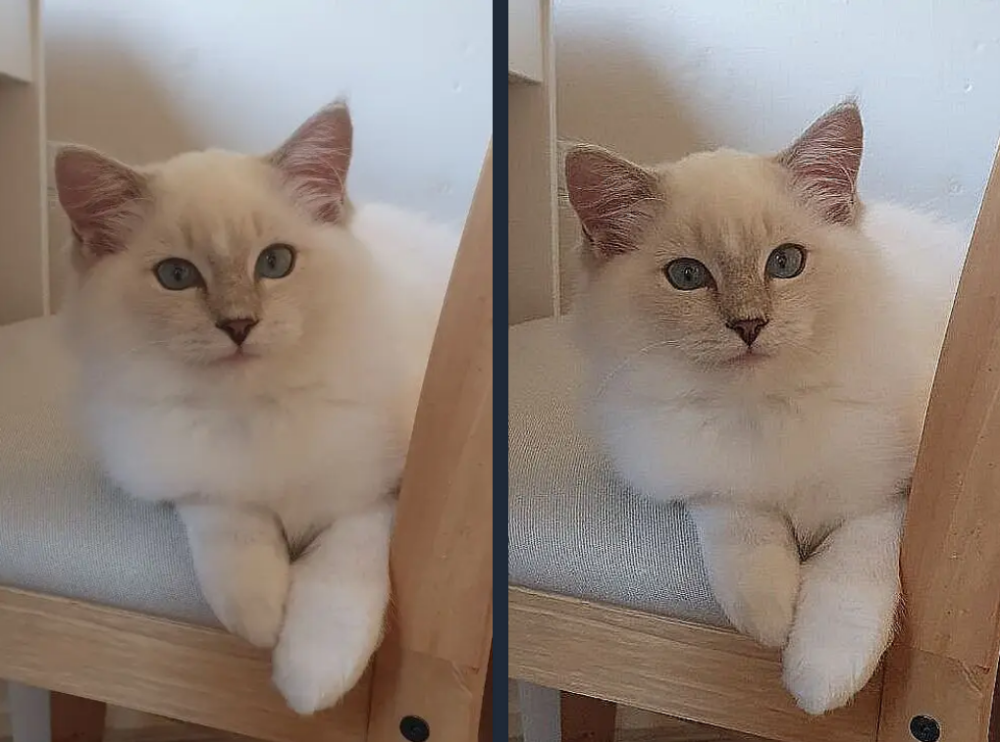

In [29]:
Image("datasets/images/Sharpen.png", width="60%")

**class [Sharpen](https://albumentations.ai/docs/api_reference/augmentations/transforms/#:~:text=class%20Sharpen) (alpha = (0.2, 0.5), lightness = (0.5, 1.0), method = 'kernel', kernel_size = 5, sigma = 1.0, p = 0.5)**

**alpha** - диапазон видимости эффекта резкости. При значении $0$ видно только исходное изображение, при значении $1$ видна только его обработанная версия. Значения должны быть в диапазоне $[0, 1]$.

**p** - вероятность применения трансформации.

# [Spatter](https://explore.albumentations.ai/transform/Spatter)

Имитирует брызги, которые могут закрывать линзу в виде дождя или грязи.

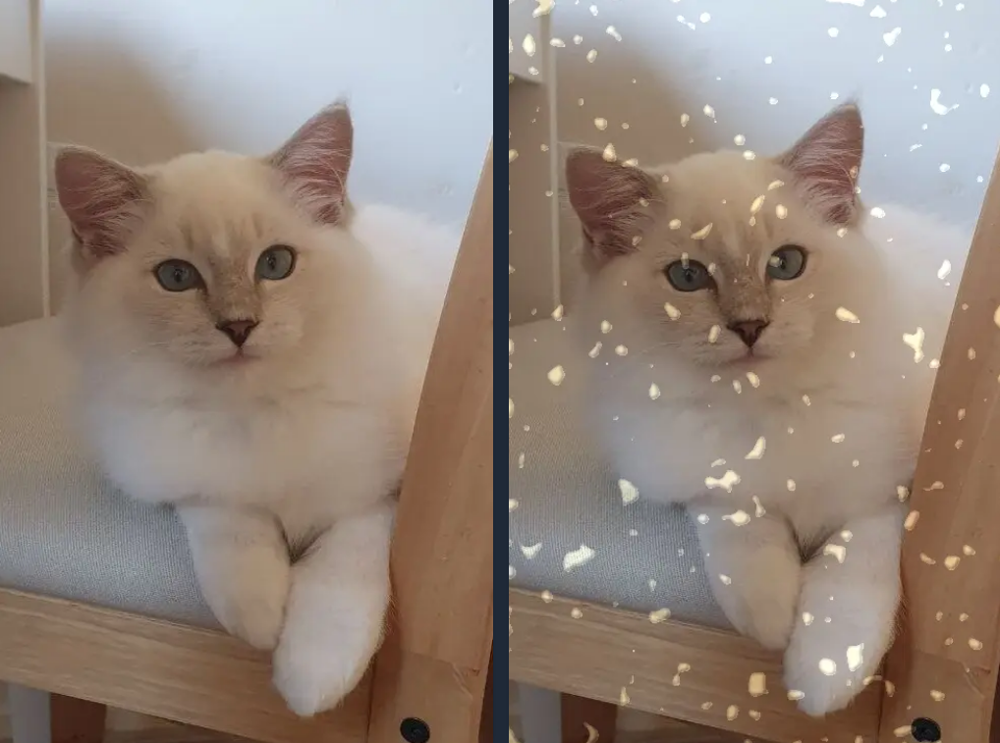

In [30]:
Image("datasets/images/Spatter.png", width="60%")

**class [Spatter](https://albumentations.ai/docs/api_reference/augmentations/transforms/#:~:text=class%20Spatter) (mean = (0.65, 0.65), std = (0.3, 0.3), gauss_sigma = (2, 2), cutout_threshold = (0.68, 0.68), intensity = (0.6, 0.6), mode = 'rain', color = None, p = 0.5)**

**gauss_sigma** - чем выше значение, тем дальше располагаются и крупнее становятся отдельные элементы эффекта.

**intensity** - интенсивность самого эффекта, то есть, насколько сильно будут видны брызги или капли. Диапазон значении $[0, 1]$. Например, 0 - не видно эффекта. 

**mode** - тип эффекта, который будет имитироваться.

- **rain** -  элементы будут выглядеть как капли дождя, брызги воды. $\newline$

- **mud** - элементы будут выглядеть как капли грязи.

**color** - цвет элементов эффекта.

**p** - вероятность применения трансформации.

# [ToFloat](https://albumentations.ai/docs/api_reference/augmentations/transforms/#:~:text=class%20ToFloat)

Делит значения пикселей на **max_value** для получения выходного массива float32, где все значения лежат в диапазоне $[0, 1]$.

In [48]:
A.ToFloat(max_value=255)

ToFloat(p=1.0, max_value=255.0)

# [Normalize](https://albumentations.ai/docs/api_reference/augmentations/transforms/#:~:text=class%20Normalize)

Применяет различные методы нормализации к изображению.

**class Normalize (mean = (0.485, 0.456, 0.406), std = (0.229, 0.224, 0.225), max_pixel_value = 255.0, normalization = 'standard', p = 1.0)**

**mean** - cредние значения для нормализации каждого канала. Используется при **normalization = "standard"**.

**std** - стандартные отклонения для нормализации каждого канала. Используется при **normalization = "standard"**.

**max_pixel_value** - максимальное значение, которое может принимать пиксель.

**normalization** - тип нормализации, который будет применяться.

- **standard** - применяет формулу $\text{img} = \frac{\text{img}\, - \,\text{mean}\, \cdot \,\text{max_pixel_value}}{\text{std} \,\cdot\, \text{max_pixel_value}}$ $\newline$

- **image** - нормализует все изображение на основе его глобального среднего значения и стандартного отклонения. $\newline$

- **image_per_channel** - нормализует изображение по каналам на основе среднего значения и стандартного отклонения каждого канала. $\newline$

- **min_max** - масштабирует значения пикселей изображения до диапазона $[0, 1]$ на основе глобальных минимальных и максимальных значений пикселей.

**p** - вероятность применения трансформации.

In [49]:
A.Normalize()

Normalize(p=1.0, mean=(0.485, 0.456, 0.406), std=(0.229, 0.224, 0.225), max_pixel_value=255.0, normalization='standard')

# Трансформации c изменением положения

# [Affine](https://explore.albumentations.ai/transform/Affine)

Изменяет изображение с помощью операций, которые можно выразить через матрицу преобразования.

Включает в себя: 
    
- **Translation** (сдвиг) – перемещение изображения по горизонтали или вертикали. $\newline$

- **Rotation** (поворот) – вращение изображения на заданный угол (в градусах). $\newline$
 
- **Scaling** (масштабирование) – увеличение или уменьшение изображения. $\newline$

- **Shear** (сдвиг по углу) – наклон изображения, при котором прямоугольник превращается в параллелограмм или даже в трапецию.

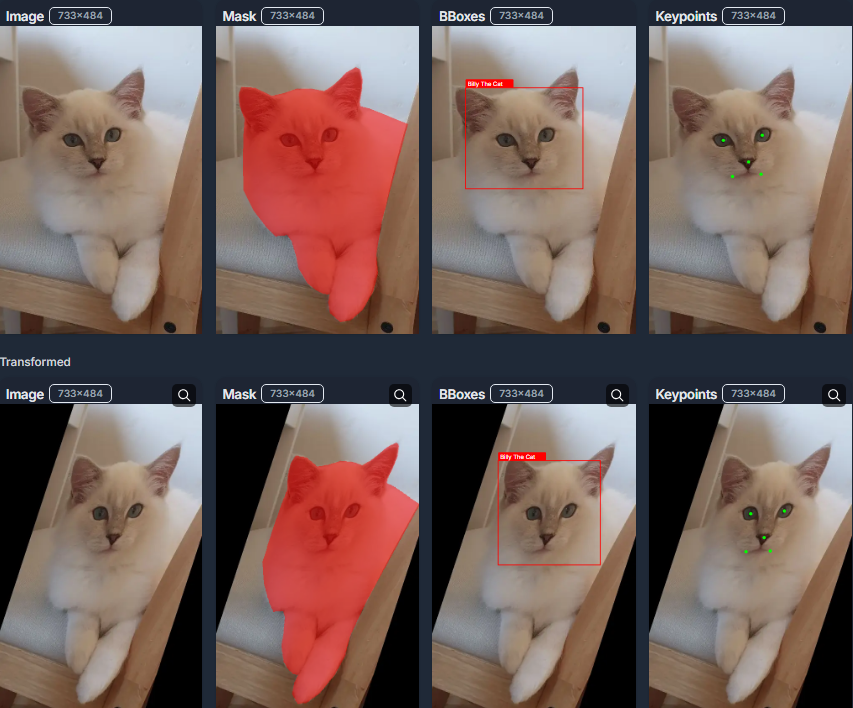

In [125]:
Image("datasets/images/Affine.png", width="60%")

**class [Affine](https://albumentations.ai/docs/api_reference/augmentations/geometric/transforms/#:~:text=class%20Affine) (scale = (1.0, 1.0), translate_percent = None, translate_px = None, rotate = 0.0, shear = (0.0, 0.0), interpolation = 1, mask_interpolation = 0, fit_output = False, keep_ratio = False, rotate_method = 'largest_box', balanced_scale = False, border_mode = 0, fill = 0, fill_mask = 0, p = 0.5)**

**scale** - задает коэффициент масштабирования изображения. Можно передать число или диапазон в виде кортежа из которого равномерно будут браться коэффициенты для каждого изображения. Например, коэффициент $0.5$ уменьшит изображение до половины от исходного. Если **keep_ratio** = **True**, то масштаб по $x$ и $y$ выбирается одинаковым, сохраняя соотношение сторон.

**keep_ratio** - если **True**, исходное соотношение сторон будет сохранено при применении случайного масштаба.

**translate_percent** и **translate_px** - задают сдвиг изображения по осям. 

- Для **translate_percent** указывается в виде доли от размеров изображения. Например, значение $0.1$ означает сдвиг на $10\%$ ширины или высоты. Можно задать одно число, диапазон (кортеж) или словарь с разными значениями для $x$ и $y:$ **translate_percent = {"x": (a, b), "y": (c, d)}**. $\newline$ 

- **translate_px** задает сдвиг в пикселях. Если не указан, используется **translate_percent**, если он тоже не задан – по умолчанию сдвиг равен 0.

**rotate** - поворот изображения. Указывается угол поворота в градусах. Вращение происходит вокруг центра изображения, а не верхнего левого угла. Можно задать одно число или диапазон (кортеж).

**shear** - определяет наклон (сдвиг) изображения. Значения указываются в градусах в диапазоне $[-360, 360]$ (разумные значения находятся в диапазоне от $-45$ до $45$ градусов). Можно задать одно число – оно будет применяться как сдвиг по оси $x$, или диапазон/словарь, чтобы задать сдвиги по обеим осям. Это можно представить, как операцию над листом бумаги, в котором нижнюю часть бумаги зафиксировали, а верхнюю часть сдвигают, например, вправо. В результате нижняя часть остаётся на месте, а верхняя смещается, и бумага становится наклонной. При этом прямые линии сохраняются прямыми, но угол между сторонами меняется – прямоугольник превращается в параллелограмм. Формально, если точка на листе имеет координаты $(x,y)$, то **shear** по оси $X$ может менять координаты так: $(x,y)→(x+k\cdot y,y)$.

**interpolation** и **mask_interpolation** - определяют, каким методом интерполировать (вычислять) новые пиксели, когда происходит преобразование. При выполнении геометрических преобразований, таких как поворот, новые координаты пикселей могут оказаться не на узлах этой сетки, а между ними (например, $[10.3, 20.7]$). Чтобы вычислить значение в позиции (например, $[10.3, 20.7]$), алгоритм использует методы интерполяции. 

**fill** и **fill_mask** - цвет (значение) для заполнения пустых областей, которые появляются, когда часть изображения оказывается вне исходной области после преобразования. Диапазон ожидаемых значений — $[0, 255]$ для uint8 изображений. **fill_mask** - то же самое, но для масок. Используется только при **border_mode = cv2.BORDER_CONSTANT**.

**border_mode** - определяет, как обрабатываются пиксели за границами исходного изображения после аффинных преобразований. 

- **cv2.BORDER_CONSTANT** - заполняет края фиксированным цветом (например, черным) $\newline$ 

- **cv2.BORDER_REPLICATE** - повторяет последний пиксель исходного изображения. $\newline$ 

- **cv2.BORDER_REFLECT** - зеркально отражает изображение относительно края. $\newline$ 

- **cv2.BORDER_WRAP** - "заворачивает" пиксели по принципу текстуры, которая повторяется бесконечно во всех направлениях. Работает так, как бы дублируя и стыкуя преобразованное изображение вокруг этого преобразованного изображения.

**balanced_scale** - обеспечивает, чтобы выбор масштаба был сбалансирован – равное количество случаев, когда изображение уменьшается и когда увеличивается. Например, если просто выбирать случайное значение из диапазона (например, $[0.5, 2]$), то, из-за несимметричности диапазона, скорее всего чаще получится увеличение (масштаб > 1). **balanced_scale = True** корректирует это.

**fit_output** - если **True**, то сохранит всю область преобразования, расширяя размер изображения, чтобы ничего не обрезалось.

**p** - вероятность применения трансформации.

# [AtLeastOneBBoxRandomCrop](https://explore.albumentations.ai/transform/AtLeastOneBBoxRandomCrop)

Выполняет обрезку изображения, гарантируя наличие хотя бы одной ограничивающей рамки (bounding box) в обрезанной области. Это полезно в задачах детекции объектов, где важно сохранить репрезентативность данных, но допустима потеря части объектов для увеличения разнообразия.

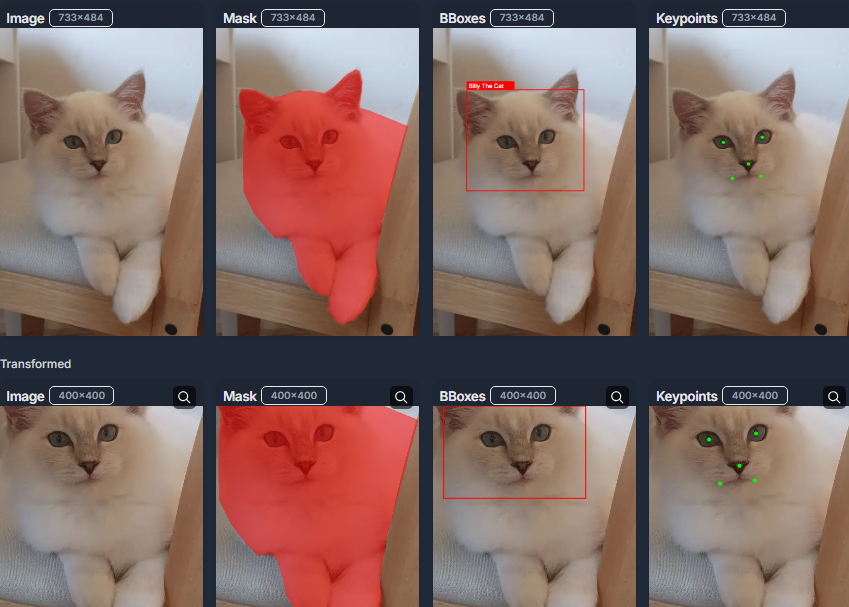

In [128]:
Image("datasets/images/AtLeastOneBBoxRandomCrop.png", width="60%")

**class [AtLeastOneBBoxRandomCrop](https://albumentations.ai/docs/api_reference/augmentations/crops/transforms/#:~:text=class%20AtLeastOneBBoxRandomCrop) (height, width, erosion_factor = 0.0, p = 1.0)**

**height** - фиксированная высота обрезанной части.

**width** - фиксированная ширина обрезанной части.

**erosion_factor** - отвечает за то, насколько нужно «уменьшить» (эрозировать) исходный ограничивающий прямоугольник (bounding box) при вычислении допустимых регионов обрезки. Для этого случайным образом выбирается опорный ограничивающий прямоугольник (bounding box) из всех доступных ограничивающих прямоугольников. Если **erosion_factor** = 0, то область вырезки должна полностью содержать исходный bounding box – никаких изменений не происходит. Если **erosion_factor** = 1, то область обрезки может располагаться практически произвольно, достаточно чтобы хоть какая-то часть bounding box пересекалась с обрезанной частью. При значениях между 0 и 1 область вырезки выбирается так, чтобы уменьшенная (эрозированная) область оказалась внутри обрезанной части. Например, процесс эрозирования может происходить так:

    x_center = (x_min + x_max) / 2
    y_center = (y_min + y_max) / 2
    width = (x_max - x_min) * (1 - erosion_factor)
    height = (y_max - y_min) * (1 - erosion_factor)
    new_x_min = x_center - width / 2
    new_y_min = y_center - height / 2
 
**p** - вероятность применения трансформации.

# [BBoxSafeRandomCrop](https://explore.albumentations.ai/transform/BBoxSafeRandomCrop)

Выполняет обрезку изображения, гарантируя наличие всех ограничивающих рамок в обрезанной области. Это полезно в задачах детекции объектов, где необходимо сохранить все ограничивающие рамки, потеря любой ограничивающей рамки может быть критичной или когда обучается модель, которая должна обнаруживать несколько объектов одновременно.

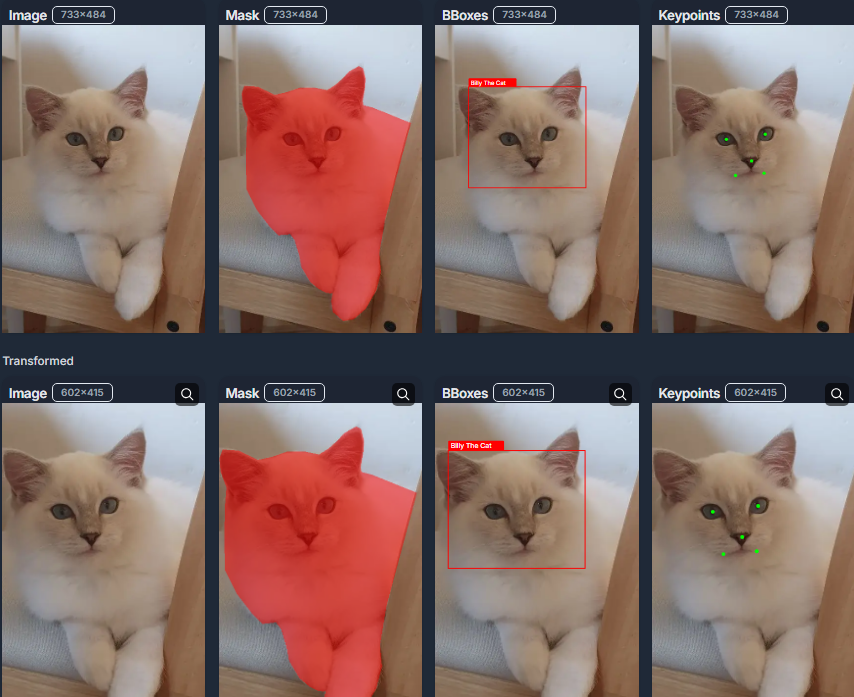

In [130]:
Image("datasets/images/BBoxSafeRandomCrop.png", width="60%")

**class [BBoxSafeRandomCrop](https://albumentations.ai/docs/api_reference/augmentations/crops/transforms/#:~:text=class%20BBoxSafeRandomCrop) (erosion_rate = 0.0, p = 1.0)**

**erosion_rate** - работает так же, как в **AtLeastOneBBoxRandomCrop**, только вместо случайного выбора опорного ограничивающего прямоугольника выбирается область, которая объединяет все ограничивающие прямоугольники.

**p** - вероятность применения трансформации.

# [RandomCrop](https://explore.albumentations.ai/transform/RandomCrop)

Обрезать случайную часть входных данных.

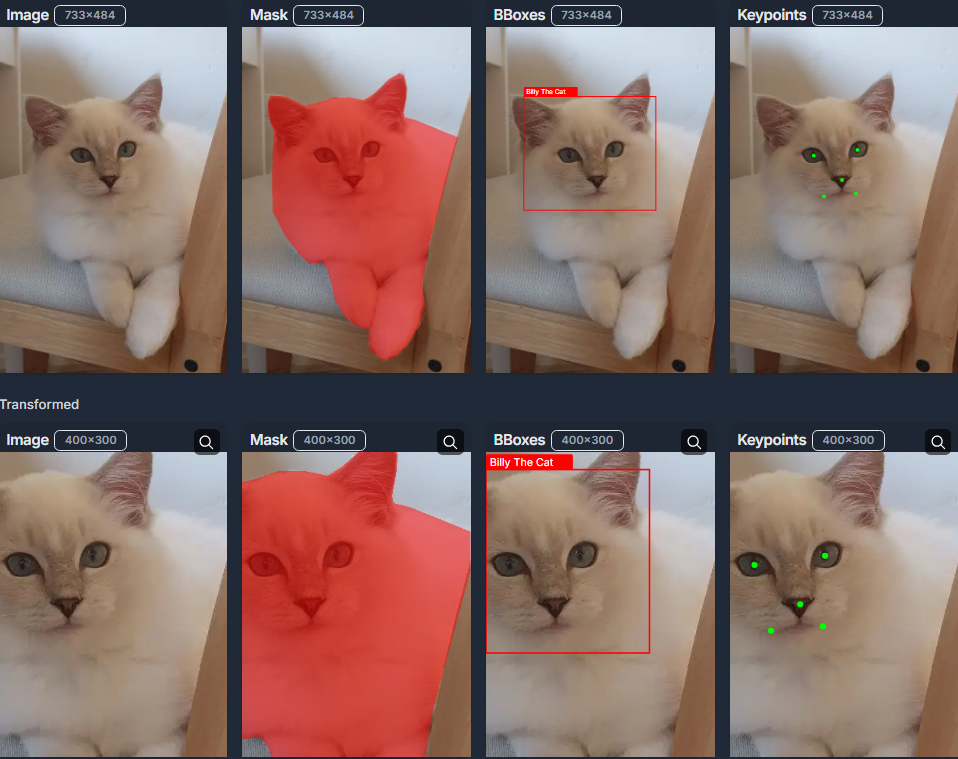

In [13]:
Image("datasets/images/RandomCrop.png", width="60%")

**class [RandomCrop](https://albumentations.ai/docs/api_reference/augmentations/crops/transforms/#:~:text=class%20RandomCrop) (height, width, pad_if_needed = False, pad_position = 'center', border_mode = 0, fill = 0.0, fill_mask = 0.0, p = 1.0)**

**height** - фиксированная высота обрезанной части.

**width** - фиксированная ширина обрезанной части.

**pad_if_needed** - нужно ли добавлять отступ, если размер обрезки превышает размер изображения. Если размер обрезки превышает размер изображения, a **pad_if_needed = False**, то вызовется исключение. 

**border_mode** - определяет, как обрабатываются пиксели за границами исходного изображения, если размер обрезки превышает размер изображения. 

- **cv2.BORDER_CONSTANT** - заполняет края фиксированным цветом (например, черным) $\newline$ 

- **cv2.BORDER_REPLICATE** - повторяет последний пиксель исходного изображения. $\newline$ 

- **cv2.BORDER_REFLECT** - зеркально отражает изображение относительно края. $\newline$ 

- **cv2.BORDER_WRAP** - "заворачивает" пиксели по принципу текстуры, которая повторяется бесконечно во всех направлениях. Работает так, как бы дублируя и стыкуя обрезанное изображение вокруг обрезанного изображения.

**fill** и **fill_mask** - цвет (значение) для заполнения пустых областей, которые появляются, когда часть изображения оказывается вне исходной области после обрезания. Диапазон ожидаемых значений — $[0, 255]$ для uint8 изображений. **fill_mask** - то же самое, но для масок. Используется только при **border_mode = cv2.BORDER_CONSTANT**.

**pad_position** - положение, где будет обрезанное изображение, если размер обрезки превышает размер исходного изображения. Возможные значения: **center**, **top_left**, **top_right**, **bottom_left**, **bottom_right** и **random**.

**p** - вероятность применения трансформации.

# [RandomResizedCrop](https://explore.albumentations.ai/transform/RandomResizedCrop)

Обрезает случайную часть входного изображения, а затем изменяет размер обрезки до указанного размера.

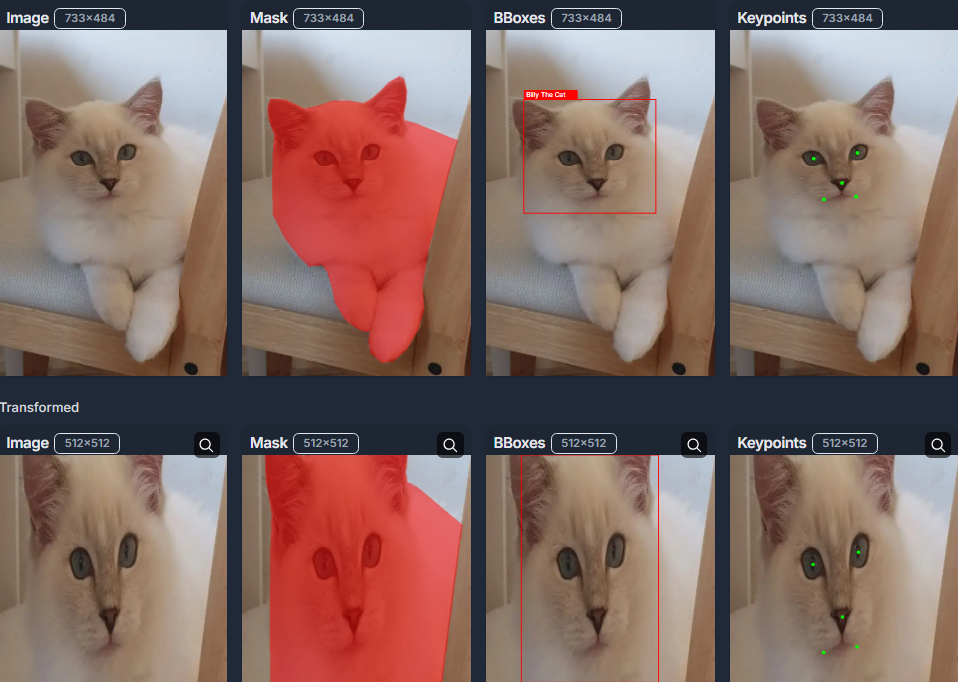

In [14]:
Image("datasets/images/RandomResizedCrop.png", width="60%")

**class [RandomResizedCrop](https://albumentations.ai/docs/api_reference/augmentations/crops/transforms/#:~:text=class%20RandomResizedCrop) (size, scale=(0.08, 1.0), ratio=(0.75, 1.3333), interpolation=1, mask_interpolation=0, p=1.0)** 

**size** - размер выходного изображения. Значение: **(высота, ширина)** в виде кортежа. 

**scale** - диапазон случайного размера обрезки относительно входного размера. Например, (0.08, 1.0) означает, что размер обрезки будет между 8% и 100% входного размера.

**ratio** - диапазон соотношения сторон обрезанного изображения. Например, (0.75, 1.3333) допускает соотношения сторон от 3:4 до 4:3.

**p** - вероятность применения трансформации.

# [CoarseDropout](https://explore.albumentations.ai/transform/CoarseDropout)

Случайным образом удаляет прямоугольные области из изображения, чтобы имитировать различные размеры объектов, которые могут перекрывать нужные объекты на изображении в реальных условиях.

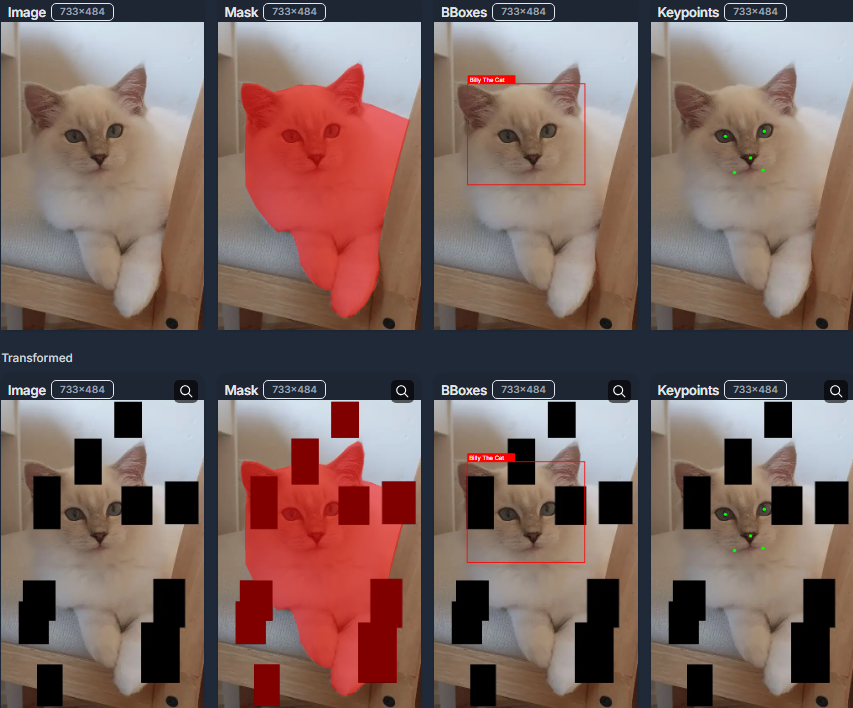

In [8]:
Image("datasets/images/CoarseDropout.png", width="60%")

**class [CoarseDropout](https://albumentations.ai/docs/api_reference/augmentations/dropout/coarse_dropout/#:~:text=class%20CoarseDropout) (num_holes_range = (1, 2), hole_height_range = (0.1, 0.2), hole_width_range = (0.1, 0.2), fill = 0, fill_mask = None, p = 0.5)**

**num_holes_range** - диапазон для количества прямоугольных областей в виде кортежа.

**hole_height_range** - диапазон для высоты прямоугольных областей в виде кортежа. Если **int**, указывает абсолютные значения пикселей. Если **float**, интерпретируется как доля высоты изображения.

**hole_width_range** - диапазон для ширины прямоугольных областей в виде кортежа. Если **int**, указывает абсолютные значения пикселей. Если **float**, интерпретируется как доля ширины изображения.

**fill** - задаёт, каким образом заполняются значения замаскированных пикселей.

- **int** или **float** - все пиксели в области маскирования заполняются этим значением во всех каналах.

- **tuple** - для каждого канала используется соответствующее значение из кортежа.

- **random** - каждый пиксель в области маскирования заполняется случайными значениями, причём для каждого пикселя значения генерируются независимо.

- **random_uniform** - для каждой маскированной области генерируется один случайный цвет и вся область заполняется именно этим единым случайным цветом.

- **inpaint_telea** и **inpaint_ns** -  используется алгоритм inpainting OpenCV. Вместо простого заполнения, замаскированные области заполняются, основываясь на информации из окружающих пикселей с использованием данного алгоритма восстановления.

**fill_mask** - задаёт, каким образом заполняются значения замаскированных пикселей для масок. 

**p** - вероятность применения трансформации.

# [ConstrainedCoarseDropout](https://explore.albumentations.ai/transform/ConstrainedCoarseDropout)

«Выбрасывает» (dropout) части изображения, создавая так называемые «дыры» именно в тех объектах, которые нам интересны (маски, ограничивающие прямоугольники).

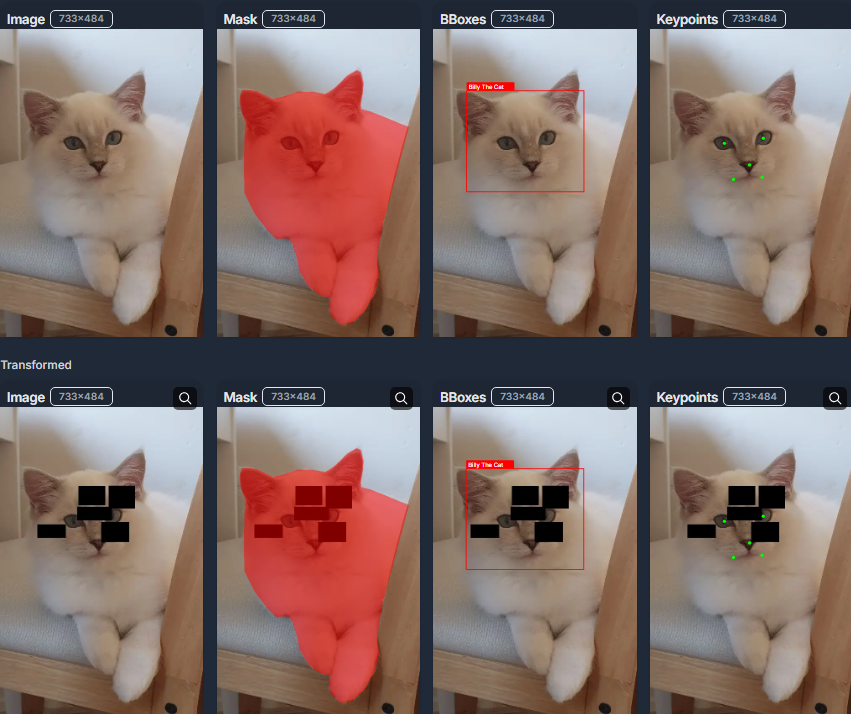

In [9]:
Image("datasets/images/ConstrainedCoarseDropout.png", width="60%")

**class [ConstrainedCoarseDropout](https://albumentations.ai/docs/api_reference/augmentations/dropout/coarse_dropout/#:~:text=class%20ConstrainedCoarseDropout) (num_holes_range = (1, 1), hole_height_range = (0.1, 0.1), hole_width_range = (0.1, 0.1), fill = 0, fill_mask = None, p = 0.5, mask_indices = None, bbox_labels = None)**

**num_holes_range** - диапазон количества дыр в виде кортежа, которые будут созданы для каждого целевого объекта. Например, если указано $(2, 4)$, то для каждого объекта будет выбрано случайное число **N** в диапазоне от 2 до 4, и затем для каждого объекта создадутся ровно **N** дыр. 

**hole_height_range** - диапазон для высоты каждой дыры, заданный в виде доли от размера объекта. Например, $(0.2, 0.4)$ означает, что высота каждой дыры будет от $20\%$ до $40\%$ от высоты бокса. Для объектов, заданных маской, высота дыры вычисляется как доля от квадратного корня площади компоненты маски. 

**hole_width_range** - диапазон для ширины каждой дыры, заданный в виде доли от размера объекта. Например, $(0.2, 0.4)$ означает, что высота каждой дыры будет от $20\%$ до $40\%$ от ширины бокса. Для объектов, заданных маской, ширина дыры вычисляется как доля от квадратного корня площади компоненты маски. 

**fill** - задаёт, каким образом заполняются значения замаскированных пикселей.

- **int** или **float** - все пиксели в области маскирования заполняются этим значением во всех каналах.

- **tuple** - для каждого канала используется соответствующее значение из кортежа.

- **random** - каждый пиксель в области маскирования заполняется случайными значениями, причём для каждого пикселя значения генерируются независимо.

- **random_uniform** - для каждой маскированной области генерируется один случайный цвет и вся область заполняется именно этим единым случайным цветом.

- **inpaint_telea** и **inpaint_ns** -  используется алгоритм inpainting OpenCV. Вместо простого заполнения, замаскированные области заполняются, основываясь на информации из окружающих пикселей с использованием данного алгоритма восстановления.

**fill_mask** - задаёт, каким образом заполняются значения замаскированных пикселей для масок. 

**mask_indices** - cписок индексов ( $\text{List[int]}$ ) классов, по которым выбираются целевые объекты в сегментационной маске. Только объекты, имеющие один из этих индексов, будут подвергнуты dropout'у.

**bbox_labels** - cписок меток ( $\text{List[str | int | float]}$ ) классов, по которым выбираются целевые объекты среди ограничивающих прямоугольников. Только объекты, имеющие один из этих меток, будут подвергнуты dropout'у.

**p** - вероятность применения трансформации.

# [XYMasking](https://explore.albumentations.ai/transform/XYMasking)

Применяет маскирующие полосы к изображению, как по горизонтали (ось X), так и по вертикали (ось Y). Это преобразование полезно для обучения моделей распознаванию изображений с различными условиями видимости. Оно особенно эффективно для изображений спектрограмм, позволяя использовать спектральную и частотную маскировку для повышения надежности модели.

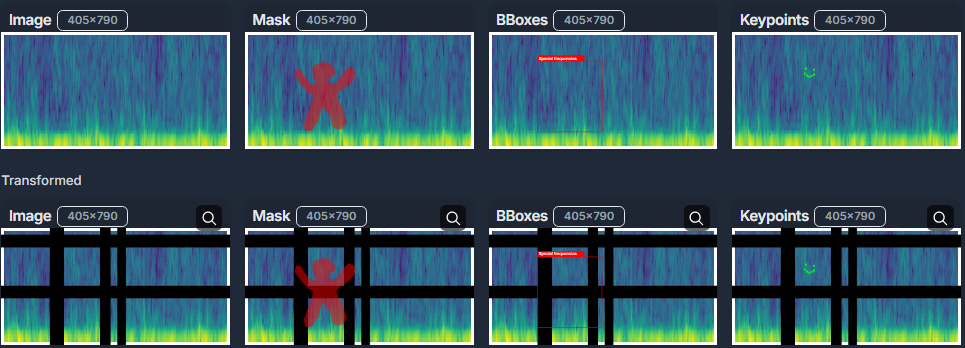

In [36]:
Image("datasets/images/XYMasking.png", width="60%")

**class [XYMasking](https://albumentations.ai/docs/api_reference/augmentations/dropout/xy_masking/) (num_masks_x = 0, num_masks_y = 0, mask_x_length = 0, mask_y_length = 0, fill = 0, fill_mask = None, p = 0.5)**

**num_masks_x** - число (**int**) или диапазон (**tuple**) вертикальных полос для маскировки.

**num_masks_y** - число (**int**) или диапазон (**tuple**) горизонтальных полос для маскировки.

**mask_x_length** - задает толщину полос по вертикали. Значения: число (**int**) или диапазон (**tuple**).

**mask_y_length** - задает толщину полос по горизонтали. Значения: число (**int**) или диапазон (**tuple**).

**fill** - задаёт, каким образом заполняются значения замаскированных пикселей.

- **int** или **float** - все пиксели в области маскирования заполняются этим значением во всех каналах.

- **tuple** - для каждого канала используется соответствующее значение из кортежа.

- **random** - каждый пиксель в области маскирования заполняется случайными значениями, причём для каждого пикселя значения генерируются независимо.

- **random_uniform** - для каждой маскированной области генерируется один случайный цвет и вся область заполняется именно этим единым случайным цветом.

- **inpaint_telea** и **inpaint_ns** -  используется алгоритм inpainting OpenCV. Вместо простого заполнения, замаскированные области заполняются, основываясь на информации из окружающих пикселей с использованием данного алгоритма восстановления.

**fill_mask** - задаёт, каким образом заполняются значения замаскированных пикселей для масок. 

**p** - вероятность применения трансформации.

# [D4](https://explore.albumentations.ai/transform/D4)

Включает такие преобразования, как 1. тождественность - преобразование не применяется, 2. поворот на 90 градусов против часовой стрелки, 3. поворот на 180 градусов, 4. поворот на 270 градусов против часовой стрелки, 5. отражение относительно вертикальной средней линии, 6. отражение относительно антидиагонали, 7. отражение относительно горизонтальной средней линии и 8. отражение относительно главной диагонали.

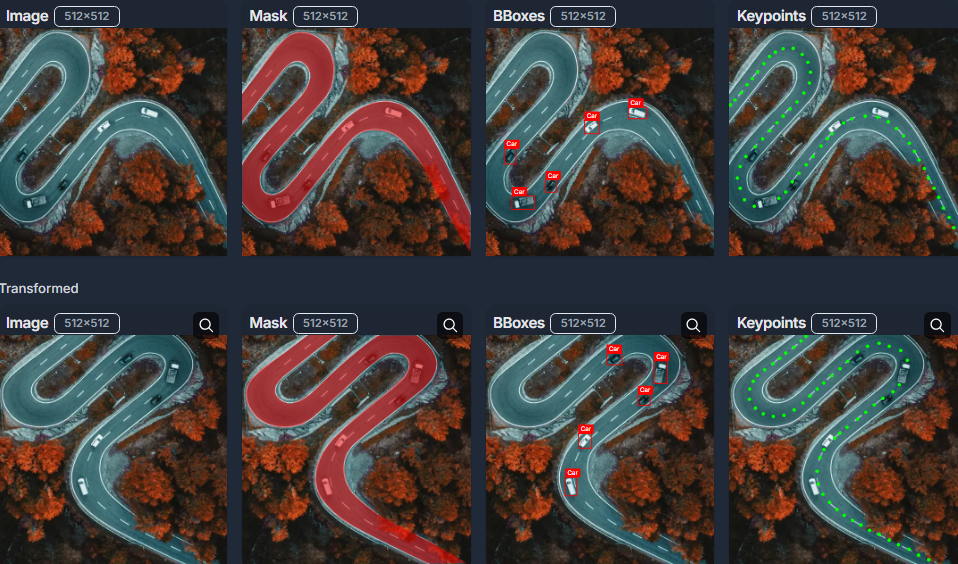

In [21]:
Image("datasets/images/D4.png", width="60%")

**class [D4](https://albumentations.ai/docs/api_reference/augmentations/geometric/transforms/#:~:text=class%20D4) (p = 1.0)**

**p** - вероятность применения трансформации.

# [Rotate](https://explore.albumentations.ai/transform/Rotate)

Поворачивает изображение на угол, выбранный случайным образом из равномерного распределения.

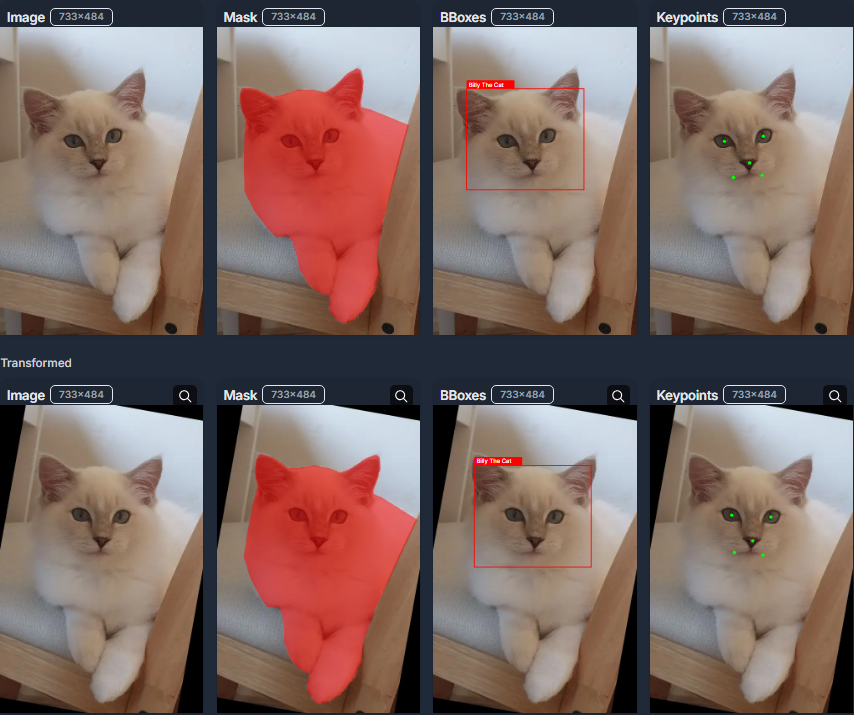

In [33]:
Image("datasets/images/Rotate.png", width="60%")

**class [Rotate](https://albumentations.ai/docs/api_reference/augmentations/geometric/rotate/#:~:text=class%20Rotate) (limit = (-90, 90), interpolation = 1, border_mode = 0, rotate_method = 'largest_box', crop_border = False, mask_interpolation = 0, fill = 0, fill_mask = 0, p = 0.5)**

**limit** - диапазон в виде кортежа, из которого выбирается случайный угол в градусах для поворота. 

**border_mode** - определяет, как обрабатываются пиксели за границами исходного изображения (темные части на изображении сверху).

- **cv2.BORDER_CONSTANT** - заполняет края фиксированным цветом (например, черным) $\newline$ 

- **cv2.BORDER_REPLICATE** - повторяет последний пиксель исходного изображения. $\newline$ 

- **cv2.BORDER_REFLECT** - зеркально отражает изображение относительно края. $\newline$ 

- **cv2.BORDER_WRAP** - "заворачивает" пиксели по принципу текстуры, которая повторяется бесконечно во всех направлениях. Работает так, как бы дублируя и стыкуя повернутое изображение вокруг полученного повернутого изображения.

**fill** и **fill_mask** - цвет (значение) для заполнения пустых областей (пиксели за границами), которые появляются после поворота изображения.

**crop_border** - обрезать ли границу после поворота, чтобы не было пустых областей. Если True, размер выходного изображения может отличаться от входного.

**interpolation** и **mask_interpolation** - определяют, каким методом интерполировать (вычислять) новые пиксели, когда происходит преобразование. При выполнении геометрических преобразований, таких как поворот, новые координаты пикселей могут оказаться не на узлах этой сетки, а между ними (например, $[10.3, 20.7]$). Чтобы вычислить значение в позиции (например, $[10.3, 20.7]$), алгоритм использует методы интерполяции. 

**p** - вероятность применения трансформации.

# [SafeRotate](https://explore.albumentations.ai/transform/SafeRotate)

То же самое, что **Rotate**, только **[SafeRotate](https://albumentations.ai/docs/api_reference/augmentations/geometric/rotate/#:~:text=class%20SafeRotate)** гарантирует, что все повернутое изображение впишется в исходный кадр, уменьшая его масштаб при необходимости.

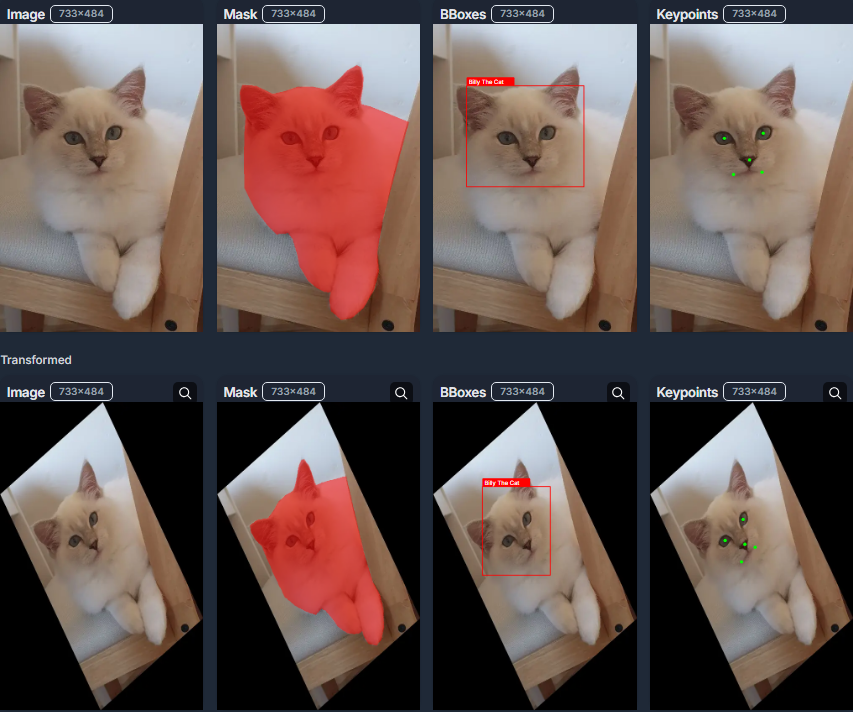

In [35]:
Image("datasets/images/SafeRotate.png", width="60%")

In [43]:
A.SafeRotate()

SafeRotate(p=0.5, limit=(-90.0, 90.0), interpolation=1, border_mode=0, fill=0.0, fill_mask=0.0, rotate_method='largest_box', mask_interpolation=0)

# [RandomRotate90](https://explore.albumentations.ai/transform/RandomRotate90)

Позволяет случайным образом повернуть изображение на 90 градусов ноль или более раз.

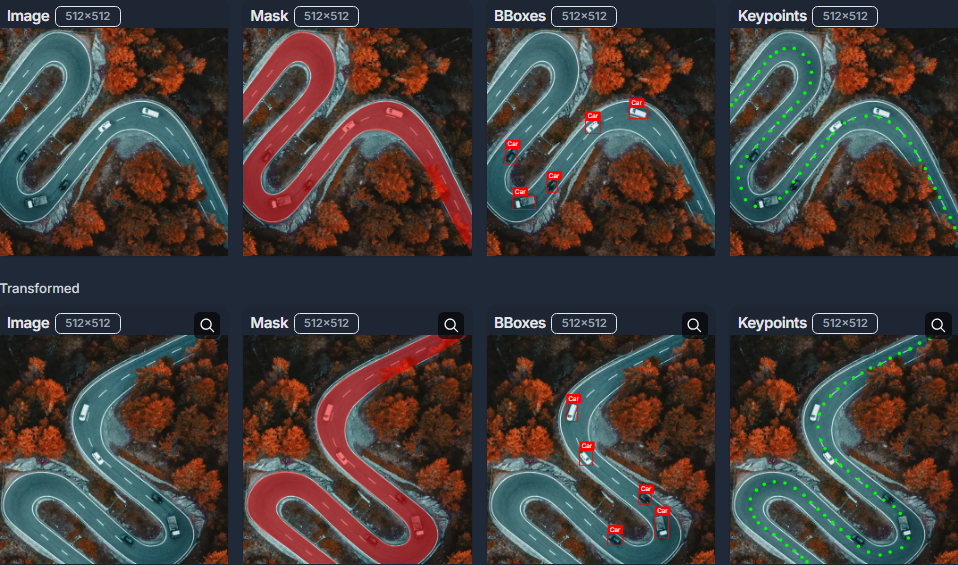

In [34]:
Image("datasets/images/RandomRotate90.png", width="60%")

**class [RandomRotate90](https://albumentations.ai/docs/api_reference/augmentations/geometric/rotate/#:~:text=class%20RandomRotate90) (p = 1)**

**p** - вероятность применения трансформации.

# [Transpose](https://explore.albumentations.ai/transform/Transpose)

Транспонирует изображение, поменяв местами строки и столбцы. Это преобразование переворачивает изображение по его главной диагонали, фактически меняя его ширину и высоту. Это эквивалентно повороту на 90 градусов по часовой стрелке с последующим горизонтальным отражением.

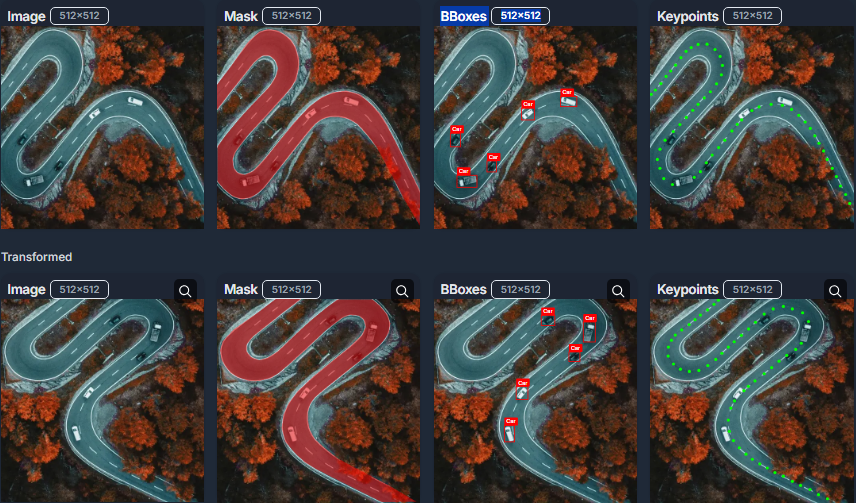

In [44]:
Image("datasets/images/Transpose.png", width="60%")

**class [Transpose](https://albumentations.ai/docs/api_reference/augmentations/geometric/transforms/#:~:text=class%20Transpose) (p = 0.5)**

**p** - вероятность применения трансформации.

# [HorizontalFlip](https://explore.albumentations.ai/transform/HorizontalFlip)

Зеркальное отражение изображения по оси **Y**.

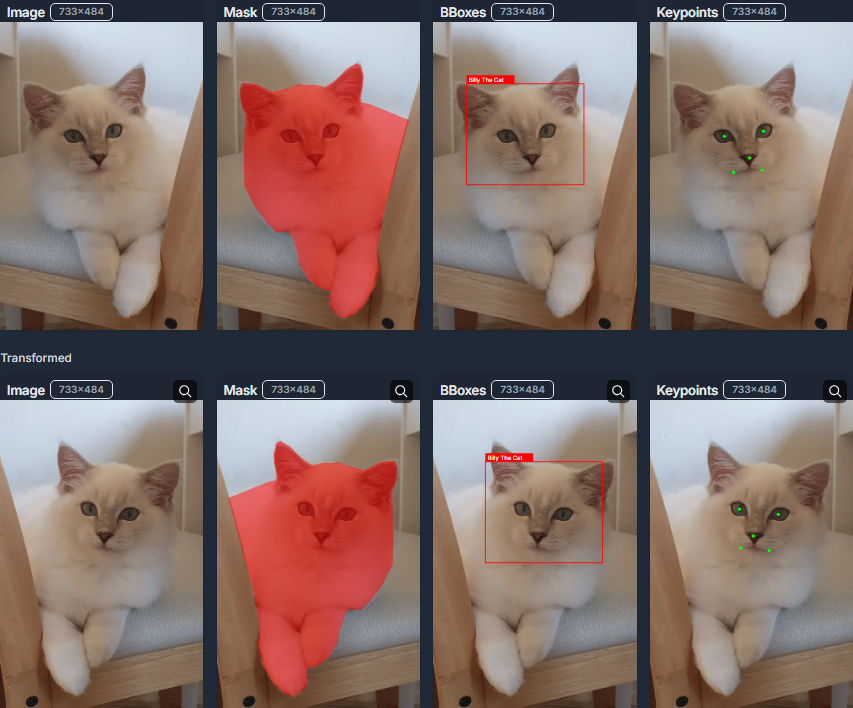

In [46]:
Image("datasets/images/HorizontalFlip.png", width="60%")

**class [HorizontalFlip](https://albumentations.ai/docs/api_reference/augmentations/geometric/transforms/#:~:text=class%20HorizontalFlip) (p = 0.5)**

**p** - вероятность применения трансформации.

# [VerticalFlip](https://explore.albumentations.ai/transform/VerticalFlip)

Зеркальное отражение изображения по оси **X**.

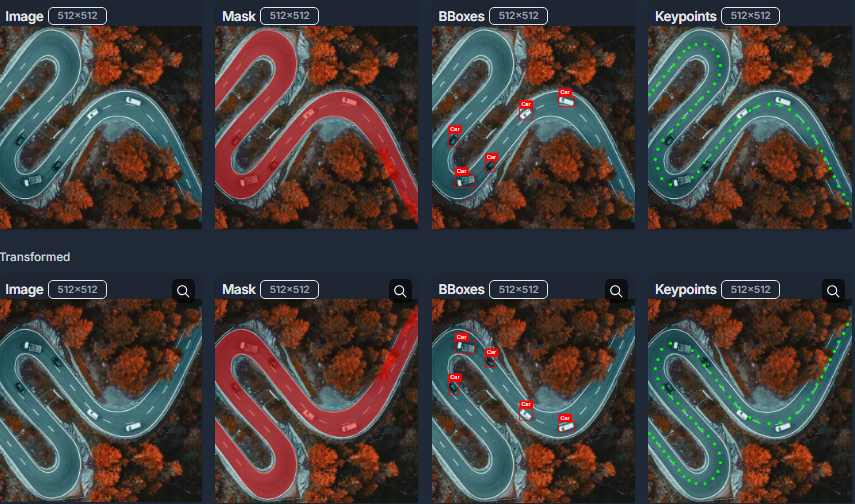

In [48]:
Image("datasets/images/VerticalFlip.png", width="60%")

**class [VerticalFlip](https://albumentations.ai/docs/api_reference/augmentations/geometric/transforms/#:~:text=class%20VerticalFlip) (p = 0.5)**

**p** - вероятность применения трансформации.

# [Resize](https://explore.albumentations.ai/transform/Resize)

Изменяет размеры входного изображения до указанной высоты и ширины.

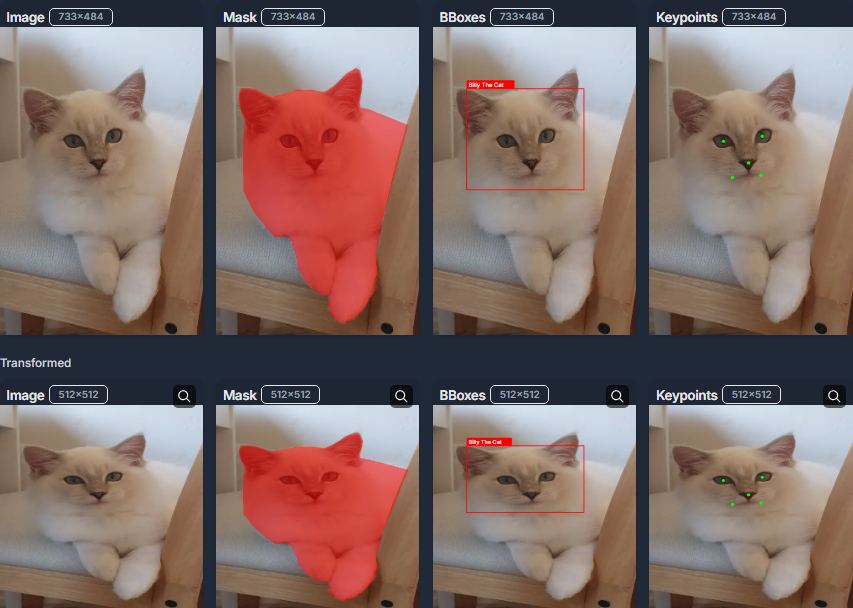

In [11]:
Image("datasets/images/Resize.png", width="60%")

**class Resize (height, width, interpolation=1, mask_interpolation=0, p=1.0)**

**height** - выходная высота изображения.

**width** - выходная ширина изображения.

**p** - вероятность применения трансформации.

# [Perspective](https://explore.albumentations.ai/transform/Perspective)

Класс **Perspective** выполняет случайное преобразование перспективы изображения. Он выбирает четыре угловые точки исходного изображения и случайным образом смещает их, основываясь на заданном параметре **scale**. Для остальных точек положение определяется так, чтобы вся геометрия картинки изменилась согласованно с изменением угловых точек. Результатом является изображение, искажённое так, как если бы его снимали под другим углом или с другой перспективы.

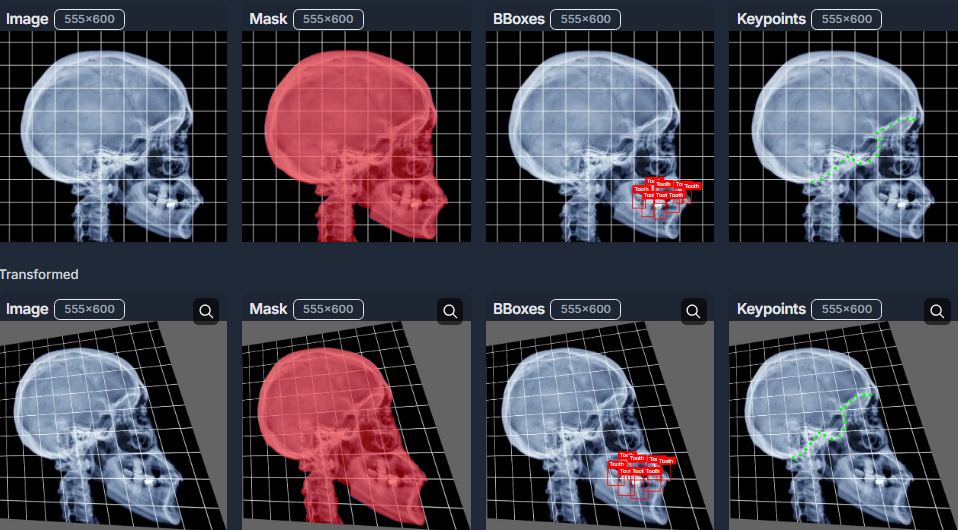

In [13]:
Image("datasets/images/Perspective.png", width="60%")

**class [Perspective](https://albumentations.ai/docs/api_reference/augmentations/geometric/transforms/#:~:text=class%20Perspective) (scale = (0.05, 0.1), keep_size = True, fit_output = False, interpolation = 1, mask_interpolation = 0, border_mode = 0, fill = 0, fill_mask = 0, p = 0.5)**

**scale** - определяет, насколько сильно случайно смещаются угловые точки изображения от их исходных позиций. Для каждой из четырёх углов вычисляется случайное смещение, величина которого определяется «стандартным отклонением» нормального распределения. Значения: $[0, +∞]$ в виде кортежа.

**keep_size** - определяет, нужно ли возвращать изображение к исходному размеру после применения преобразования. **True** - да, **False** - нет. 

**border_mode** - определяет, как обрабатываются пиксели за границами исходного изображения (серые части на изображении сверху).

- **cv2.BORDER_CONSTANT** - заполняет края фиксированным цветом (например, серым) $\newline$ 

- **cv2.BORDER_REPLICATE** - повторяет последний пиксель исходного изображения. $\newline$ 

- **cv2.BORDER_REFLECT** - зеркально отражает изображение относительно края. $\newline$ 

- **cv2.BORDER_WRAP** - "заворачивает" пиксели по принципу текстуры, которая повторяется бесконечно во всех направлениях. Работает так, как бы дублируя и стыкуя преобразованное изображение вокруг полученного преобразованного изображения.

**fill** и **fill_mask** - цвет (значение) для заполнения пустых областей, которые появляются, когда часть изображения оказывается вне исходной области после преобразования. Диапазон ожидаемых значений — $[0, 255]$ для uint8 изображений. **fill_mask** - то же самое, но для масок. Используется только при **border_mode = cv2.BORDER_CONSTANT**.

**fit_output** - если установлено в **True**, то перед масштабированием обратно к исходному размеру (если **keep_size = True**) происходит вычисление оптимального размера так, чтобы сохранить всё изображение после преобразования. Если **False**, части преобразованного изображения могут оказаться за пределами плоскости изображения.

**interpolation** и **mask_interpolation** - определяют, каким методом интерполировать (вычислять) новые пиксели, когда происходит преобразование. При выполнении геометрических преобразований новые координаты пикселей могут оказаться не на узлах этой сетки, а между ними (например, $[10.3, 20.7]$). Чтобы вычислить значение в позиции (например, $[10.3, 20.7]$), алгоритм использует методы интерполяции. 

**p** - вероятность применения трансформации.

# [ElasticTransform](https://explore.albumentations.ai/transform/ElasticTransform)

Создаёт эффект «эластичной деформации» изображения – как будто изображение растягивается, сжимается или расплывается в разных местах, но при этом структура (например, контуры объектов) остаётся узнаваемой.

Сначала для каждого пикселя создаётся случайное смещение. Это делается путем генерации двух (или одной, если **same_dxdy = True**) шумовых карт, где значения выбираются либо по нормальному (гауссовскому), либо равномерному распределению (параметр **noise_distribution**). Эти карты определяют, насколько сдвинется каждый пиксель по оси **X** и **Y**.

Полученные случайные значения умножаются на коэффициент **alpha**. Он определяет, насколько сильной будет деформация – чем больше **alpha**, тем сильнее смещение (то есть «растяжение» или «сжатие»).

Чтобы деформация выглядела естественно, шумовые карты сглаживаются Гауссовым фильтром с параметром **sigma** (стандартное отклонение). Более высокое **sigma** приводит к более плавным деформациям.

На основе полученных смещений создаются карты координат (дискретные поля, по которым определяется новое положение каждого пикселя). Затем, используя выбранный метод интерполяции (параметр **interpolation** для изображений и **mask_interpolation** для масок), изображение «перепроецируется» согласно этим картам.

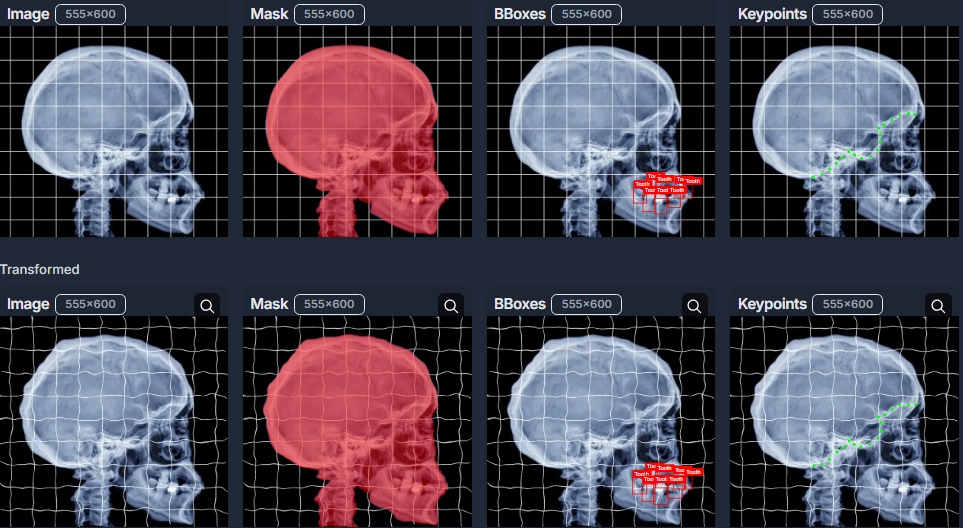

In [33]:
Image("datasets/images/ElasticTransform.png", width="70%")

**class [ElasticTransform](https://albumentations.ai/docs/api_reference/augmentations/geometric/transforms/#:~:text=class%20ElasticTransform) (alpha = 1, sigma = 50, interpolation = 1, approximate = False, same_dxdy = False, mask_interpolation = 0, noise_distribution = 'gaussian', keypoint_remapping_method = 'mask', p = 0.5)**

**alpha** - сила смещения. Чем больше **alpha**, тем сильнее деформация. Значения: $[0, +∞]$, где $0$ - нет смещении. 

**sigma** - cтандартное отклонение фильтра Гаусса. Более высокие значения приводят к более гладким искажениям. Значения: $[1, +∞]$

**approximate** - если **True**, используется упрощённая (быстрая) версия Гауссова фильтра. **False** - более точная версия. 

**same_dxdy** - если **True**, смещения по **X** и **Y** генерируются одинаковыми, что ускоряет вычисления, но уменьшает разнообразие деформаций.

**interpolation** - метод интерполяции для преобразования изображения.

**mask_interpolation** - метод интерполяции для масок.

**noise_distribution** - распределение, используемое для генерации карт смещения. Значения: **gaussian** для нормального распределения или **uniform** для равномерного.

**keypoint_remapping_method** – способ пересчёта координат ключевых точек: **mask** (быстро) или **direct** (точнее).

**p** - вероятность применения трансформации.

# [GridDistortion](https://explore.albumentations.ai/transform/GridDistortion)

Это преобразование делит изображение на сетку и случайным образом искажает каждую ячейку, создавая локальные эффекты деформации. Изображение разделяется на равные по размеру области, которые впоследствии будут искажаться независимо друг от друга.

Параметр **num_steps** определяет, на сколько ячеек разбивается изображение по горизонтали и вертикали. Например, если **num_steps = 5**, то изображение делится на 5 равных частей по горизонтали и 5 по вертикали. Однако контрольных линий будет на одну больше для каждой оси – то есть 6 линий по горизонтали и 6 по вертикали. Эти линии представляют собой границы ячеек, то есть их пересечения образуют контрольные точки.

Для каждой контрольной горизонтальной и вертикальной линии сетки генерируются случайные коэффициенты искажения:

```python
steps_x = [1 + uniform(distort_limit) for _ in range(num_steps + 1)]
steps_y = [1 + uniform(distort_limit) for _ in range(num_steps + 1)]
```

**distort_limit** задает диапазон смещений. Например, при **distort_limit = (-0.3, 0.3)** коэффициенты будут в диапазоне $[0.7, 1.3]$

Расстояние между точками осталось одинаковым после трансформации: 100 -> 110
[100, 200, 300, 400, 500, 600] -> [110, 220, 330, 440, 550, 660]


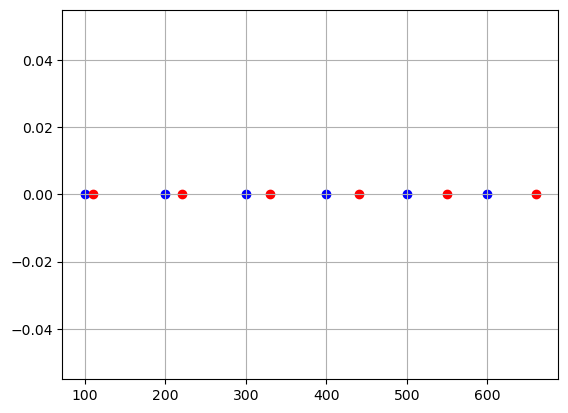

In [15]:
a = [100, 200, 300, 400, 500, 600]  # Координаты по оси x
a_t = list(map(lambda x: int(x * 1.1), a))  # Умножаем каждую координату на 1.1
y = [0, 0, 0, 0, 0, 0]

print("Расстояние между точками осталось одинаковым после трансформации: 100 -> 110")
print(a, "->", a_t)

plt.scatter(a, y, c="blue")
plt.scatter(a_t, y, c="red")
plt.grid()

**steps_x** и **steps_y** можно воспринимать, как множители:

- Если множитель меньше 1 (например, 0.8):
    Это означает, что контрольная точка сдвигается в сторону начала координат по сравнению с её исходным положением. Например, если координата равна 0.4, то после умножения на 0.8 она станет 0.32. То есть линия будет расположена ближе к нулевой границе — «сдвинутой внутрь» относительно центра изображения. $\newline$

- Если множитель больше 1 (например, 1.2):
    В этом случае контрольная точка перемещается дальше от начала координат. Например, координата 0.4 после умножения на 1.2 станет 0.48, то есть линия окажется дальше от нулевой границы — «сдвинутой наружу».

На пересечении горизонтальной и вертикальной контрольных линий создаётся контрольная точка, у которой координаты вычисляются на основе соответствующих значений из списков **steps_x** и **steps_y**.

После определения новых позиций контрольных точек для всего изображения используется билинейная интерполяция. Это позволяет вычислить смещённые координаты для каждого пикселя внутри ячейки сетки, обеспечивая плавное переходное искажение.

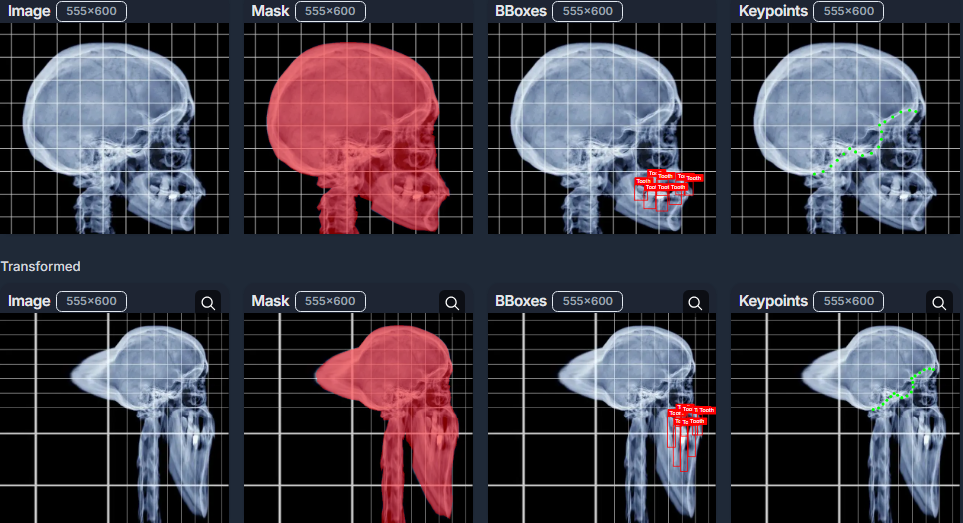

In [4]:
Image("datasets/images/GridDistortion.png", width="70%")

**class [GridDistortion](https://albumentations.ai/docs/api_reference/augmentations/geometric/transforms/#:~:text=class%20GridDistortion) (num_steps = 5, distort_limit = (-0.3, 0.3), interpolation = 1, normalized = True, mask_interpolation = 0, keypoint_remapping_method = 'mask', p = 0.5)**

**num_steps** - определяет, на сколько частей (по каждой оси) будет разделено изображение. При значении **num_steps = 5** изображение делится на 5 равномерных ячеек по горизонтали и 5 по вертикали. Чем больше **num_steps**, тем более мелкие области будут искажаться независимо. Значения: число (**int**).

**distort_limit** - задаёт диапазон случайных смещений для каждой контрольной линии. Параметр управляет, насколько сильно каждая контрольная линия (и, как следствие, область между линиями) будет смещена от своей исходной позиции. Значения: диапазон в виде кортежа.

**normalized** - если **normalized = True**, алгоритм дополнительно корректирует смещения контрольных линий так, чтобы итоговая деформация не приводила к выходу пикселей за пределы исходного изображения. Это гарантирует, что даже при сильном смещении линии вся информация останется в пределах изображения, хотя искажения могут стать менее экстремальными.

**interpolation** - метод интерполяции для преобразования изображения.

**mask_interpolation** - метод интерполяции для масок.

**keypoint_remapping_method** – способ пересчёта координат ключевых точек: **mask** (быстро) или **direct** (точнее).

**p** - вероятность применения трансформации.

# [GridElasticDeform](https://explore.albumentations.ai/transform/GridElasticDeform)

Применяет эластичные деформации к изображению с использованием сеточного подхода.

Исходное изображение делится на равномерную сетку, определяемую параметром **num_grid_xy**. Например, при $(4,\, 4)$ изображение разделяется на 4 колонки и 4 строки, а контрольные точки формируют сетку **5 x 5**.

Для каждой контрольной точки (то есть для каждой точки, где пересекаются линии сетки) генерируется два случайных смещения — по оси **X** и по оси **Y**. Эти смещения выбираются таким образом, что абсолютное значение не превышает заданное значение **magnitude**.

После того как новые положения контрольных точек вычислены, на основе исходной и деформированной сетки создается карта деформации (обычно с использованием билинейной интерполяции). Эта карта определяет, как перемещаются пиксели внутри каждой ячейки сетки.

Полученная карта применяется ко всему изображению.

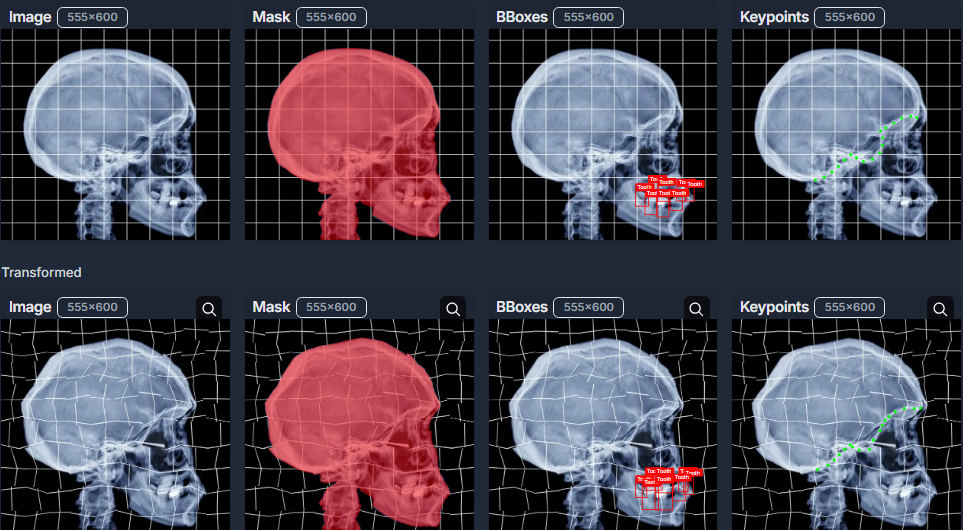

In [16]:
Image("datasets/images/GridElasticDeform.png", width="70%")

**class [GridElasticDeform](https://albumentations.ai/docs/api_reference/augmentations/geometric/transforms/#:~:text=class%20GridElasticDeform) (num_grid_xy, magnitude, interpolation = 1, mask_interpolation = 0, p = 1.0)**

**num_grid_xy** - определяет количество ячеек сетки вдоль горизонтали и вертикали. Значения: диапазон в виде кортежа (**tuple[int, int]**).

**magnitude** - максимальное смещение в пикселях, которое может быть применено к каждой контрольной точке сетки. Значения: число (**int**) > 0.

**interpolation** - метод интерполяции для преобразования изображения.

**mask_interpolation** - метод интерполяции для масок.

**p** - вероятность применения трансформации.

# [OpticalDistortion](https://explore.albumentations.ai/transform/OpticalDistortion)

Имитирует оптические искажения, которые возникают из-за особенностей оптики камеры или эффекта «рыбьего глаза». 

При каждом вызове трансформации для изображения случайно выбирается значение коэффициента из интервала distort_limit. Это значение определяет степень искажения, которое будет применено.

В зависимости от параметра **mode** используется одна из двух моделей:

- **Camera Model**:
    
    Здесь используется классическая модель оптической дисторсии, как в калибровке камеры OpenCV. Коэффициент искажения применяется ко всем точкам изображения, имитируя незначительные «деформации» из-за несовершенства объектива. $\newline$
    
- **Fisheye Model**:

    В этом режиме искажение рассчитывается по формуле $r\_dist = r \cdot (1 + gamma \cdot r^{\,2})$. Такая модель создаёт эффект «рыбьего глаза», где искажение усиливается по мере удаления от центра изображения.

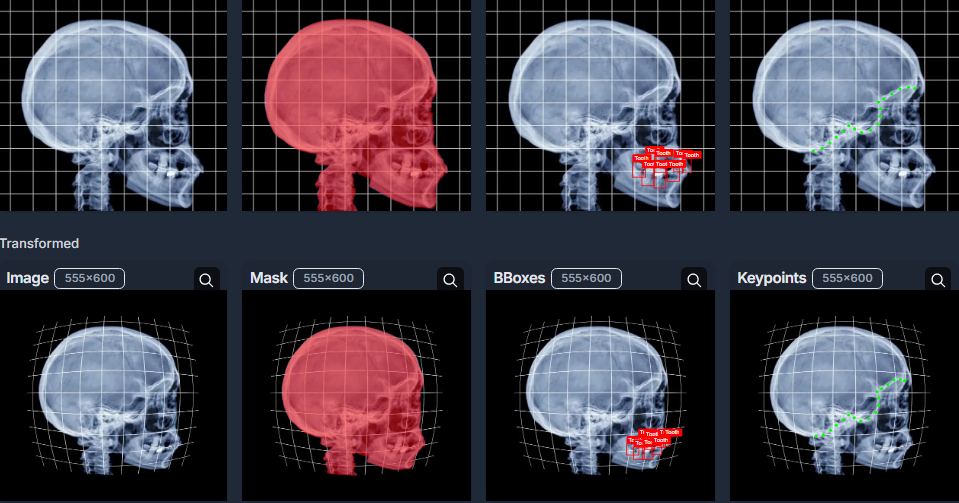

In [22]:
Image("datasets/images/OpticalDistortion.png", width="70%")

**class [OpticalDistortion](https://albumentations.ai/docs/api_reference/augmentations/geometric/transforms/#:~:text=class%20OpticalDistortion) (distort_limit = (-0.05, 0.05), interpolation = 1, mask_interpolation = 0, mode = 'camera', keypoint_remapping_method = 'mask', p = 0.5)**

**distort_limit** - диапазон коэффициента искажения. Для модели камеры (**mode = camera**) рекомендуется диапазон $(-0.05, 0.05)$, так как обычные оптические искажения для стандартных камер невелики. Для модели «рыбьего глаза» (**mode = fisheye**) допустимый диапазон расширяется (например, $(-0.3, 0.3)$), поскольку такие объективы создают более сильное радиальное искажение.

**mode** - определяет, какая модель оптического искажения будет использоваться. Значения: **camera** и **fisheye**.

**interpolation** - метод интерполяции для преобразования изображения.

**mask_interpolation** - метод интерполяции для масок.

**keypoint_remapping_method** – способ пересчёта координат ключевых точек: **mask** (быстро) или **direct** (точнее).

**p** - вероятность применения трансформации.

# [ThinPlateSpline](https://explore.albumentations.ai/transform/ThinPlateSpline)

Создает гладкие, нелинейные деформации изображения, имитируя эффект гибкого «металлического листа», который можно сгибать.

Изначально изображение делится на равномерную сетку, где точки равномерно распределены по ширине и высоте. Например, при **num_control_points = 4** создается сетка **4 x 4** (или контрольных точек 16).

Каждая контрольная точка смещается на случайное значение, выбранное из диапазона, заданного в **scale_range**.

На основе новых позиций контрольных точек алгоритм рассчитывает функцию тонкой пластинчатой сплайновой (Thin Plate Spline) интерполяции. Эта функция обеспечивает гладкое, непрерывное распределение смещений по всему изображению, минимизируя резкие изменения и создавая естественный «более сглаженный» эффект. Cоздается карта, по которой перемещаются пиксели изображения.

Полученные деформации применяются к изображению.

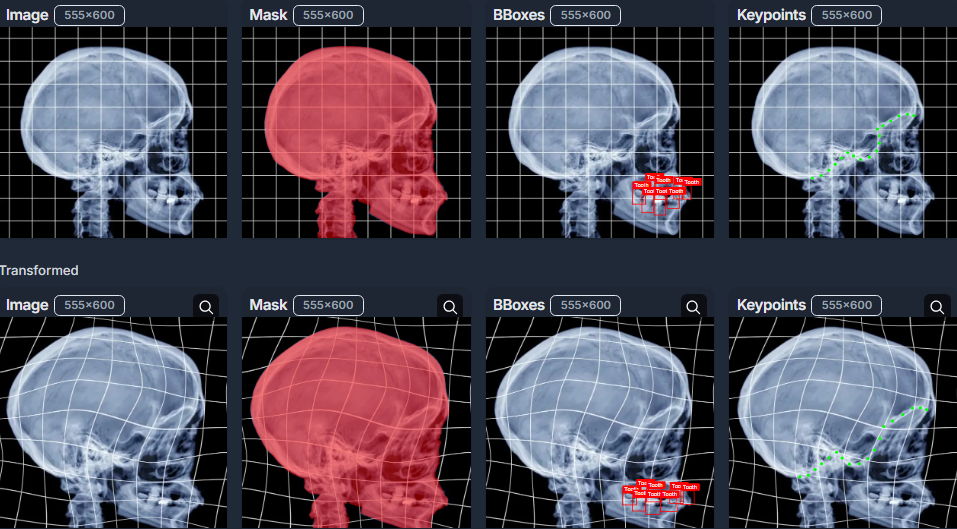

In [26]:
Image("datasets/images/ThinPlateSpline.png", width="70%")

**class [ThinPlateSpline](https://albumentations.ai/docs/api_reference/augmentations/geometric/transforms/#:~:text=class%20ThinPlateSpline) (scale_range = (0.2, 0.4), num_control_points = 4, interpolation = 1, mask_interpolation = 0, keypoint_remapping_method = 'mask', p = 0.5)**

**scale_range** - диапазон случайного смещения контрольных точек. Значения: диапазон $[0, 1]$ в виде кортежа.

- Значение 0 означает отсутствие смещения (трансформация не изменяет изображение).

- При значениях около 0.1 и ниже деформация будет слабой (слегка «подтянутая» поверхность).

- Диапазон 0.2–0.4 дает умеренные искажения.

- При значениях 0.5 и выше эффект становится более сильным и «экстремальным».

**num_control_points** - определяет количество контрольных точек вдоль каждой оси, формируя сетку из **num_control_points x num_control_points** точек. Значения: целое число >= 2.

- Минимальное значение 2 приводит к почти аффинной трансформации.

- При значениях 3–4 появляется умеренная гибкость и локальное управление деформацией.

- Значения 5 и более позволяют достичь более детального локального контроля, но могут замедлять вычисления.

**interpolation** - метод интерполяции для преобразования изображения.

**mask_interpolation** - метод интерполяции для масок.

**keypoint_remapping_method** – способ пересчёта координат ключевых точек: **mask** (быстро) или **direct** (точнее).

**p** - вероятность применения трансформации.

# [Object Detection](https://albumentations.ai/docs/getting_started/bounding_boxes_augmentation/) в albumentations

У **bounding box** есть верхний левый угол с координатами $(x\_min, y\_min)$ и нижний правый $-$ $(x\_max, y\_max)$. С помощью них в **albumentations** придумали различные форматы задания **bounding box**.

## Способы задать bounding box в albumentations:

1. **pascal_voc** $-$ формат, используемый набором данных Pascal VOC.

    Координаты ограничивающего прямоугольника кодируются четырьмя значениями в пикселях: $[x\_min, \,y\_min, \,x\_max, \,y\_max]$. $\newline$
    
2. **albumentations** $-$ собственный способ представления рамок, используемый внутри albumentations. 

    В отличие от **pascal_voc**, формат **albumentations** использует нормализованные значения. Для нормализации используются ширина и высота изображения. Формат: $[\frac{x\_min}{W}, \frac{y\_min}{H}, \frac{x\_max}{W}, \frac{y\_max}{H}]$, где $W$ и $H$ $-$ ширина и высота изображения соответственно.  $\newline$

3. **coco** $-$ формат, используемый набором данных Common Objects in Context.

    Здесь первые два числа – это координаты верхнего левого угла, а следующие два – ширина и высота **рамки** (в абсолютных пикселях). Формат: $[x\_min, \,y\_min, \,w, \,h]$, где $w$ и $h$ $-$ ширина и высота **рамки** соответственно.  $\newline$
    
4. **yolo** $-$ формат Ultralytics YOLO.

    Формат **yolo** задаёт рамку через координаты её центра, а также ширину и высоту. При этом все значения нормализованы относительно размеров изображения – то есть они находятся в диапазоне $[0, 1]$. Формат: $[x\_center, y\_center, w\,', h\,']$, где $x\_center=\frac{x\_min\,+\,x\_max}{2\,\cdot \,W};$ $y\_center=\frac{y\_min\,+\,y\_max}{2\,\cdot \,H};$ $w\,'=\frac{x\_max\,-\,x\_min}{W};$ $h\,'=\frac{y\_max\,-\,y\_min}{H};$, где $W$ и $H$ $-$ ширина и высота изображения соответственно.

# Compose в albumentations

Пример:

```python
transform = A.Compose([
    A.RandomCrop(width=450, height=450),
    A.HorizontalFlip(p=0.5),
    A.RandomBrightnessContrast(p=0.2),
], bbox_params=A.BboxParams(format='coco'))
```

У **Compose** для bounding box аугментации есть параметр **bbox_params**, в который нужно передать **A.BboxParams** с некоторыми параметрами.

### A.BboxParams

**Параметры:**

**format** - задает формат координат ограничивающих рамок. Значения:

- **pascal_voc**

- **albumentations**

- **coco**

- **yolo**

**[min_area](https://albumentations.ai/docs/getting_started/bounding_boxes_augmentation/#:~:text=min_area%20and%20min_visibility%20parameters)** - минимальная площадь в пикселях. Если площадь ограничивающего прямоугольника после аугментации становится меньше **min_area**, albumentations удалит этот прямоугольник. Поэтому возвращаемый список ограничивающих прямоугольников не будет содержать этот ограничивающий прямоугольник.

**[min_visibility](https://albumentations.ai/docs/getting_started/bounding_boxes_augmentation/#:~:text=min_area%20and%20min_visibility%20parameters)** - задает минимальную долю исходной площади рамки, которая должна остаться видимой после аугментации. После применения трансформаций вычисляется, какая часть исходной рамки осталась в пределах изображения. Если эта доля меньше указанного порога, рамка отбрасывается. Это полезно для исключения слишком «обрезанных» рамок, которые могут негативно сказаться на обучении модели.

**[label_fields](https://albumentations.ai/docs/getting_started/bounding_boxes_augmentation/#:~:text=label_fields%20parameter)** - список имен полей, в которых содержатся метки (labels) для соответствующих bounding boxes. При аугментации вместе с рамками корректируются («переназначаются» к уже обновлённым координатам) и значения из указанных полей, чтобы сохранить соответствие между рамками и их метками. Если ограничивающий прямоугольник удаляется после трансформации, поскольку он больше не виден, albumentations также удаляет метку класса для этого прямоугольника. В этот список можно задать несколько полей, чтобы можно было передать несколько меток:

```python
transform = A.Compose([
    A.RandomCrop(width=450, height=450),
    A.HorizontalFlip(p=0.5),
    A.RandomBrightnessContrast(p=0.2),
], bbox_params=A.BboxParams(format='coco', label_fields=['class_labels', 'class_categories']))

class_labels = ['cat', 'dog', 'parrot']
class_categories = ['animal', 'animal', 'item']

transformed = transform(image=image, bboxes=bboxes, class_labels=class_labels, class_categories=class_categories)
transformed_image = transformed['image']
transformed_bboxes = transformed['bboxes']
transformed_class_labels = transformed['class_labels']
transformed_class_categories = transformed['class_categories']
```

**clip** - если **True**, координаты ограничивающего прямоугольника обрезаются, чтобы оставаться в пределах границ изображения перед применением преобразований. По умолчанию: **False**.

**filter_invalid_bboxes** - если **True**, удаляет недопустимые поля (x_max < x_min или y_max < y_min) перед применением преобразований. Если **clip=True**, удаление происходит после обрезки. По умолчанию: **False**.

# OneOf

Берется список преобразований и применяется ровно одно из них, выбранное случайным образом, причем Albumentations нормализует вероятности внутренних преобразований так, чтобы их сумма равнялась 1. 

Например:

**HorizontalFlip** имеет **p=0.9**

**RandomBrightnessContrast** имеет **p=0.7**

Сумма составляет 0.9 + 0.7 = 1.6

Нормализованная вероятность для **HorizontalFlip**: 0.9 / 1.6 = 0.5625. Нормализованная вероятность для **RandomBrightnessContrast**: 0.7 / 1.6 = 0.4375. Таким образом, если **OneOf** сработает, **HorizontalFlip** будет применена в 56,25% случаев, а **RandomBrightnessContrast** будет применена в 43,75% случаев.

```python
A.OneOf([
    A.HorizontalFlip(p=0.9),
    A.RandomBrightnessContrast(p=0.7)
], p=0.5)  # вероятность 50% применить одно из вышеперечисленных преобразований
```

Так как **OneOf** в примере тоже имеет вероятность применения = 0.5, то фактическая вероятность применения каждого конкретного преобразования к исходному изображению составляет:

**HorizontalFlip**: 0.5 * 0.5625 ~ 0.28

**RandomBrightnessContrast**: 0.5 * 0.4375 ~ 0.22

# SomeOf

Случайным образом выбирает **n** преобразовании из списка и пытается применить их последовательно. Она хорошо подходит, когда нужно одновременно разнообразить аугментации, но не применять все или не применять ровно одну (в отличие от **OneOf**). 

**n** - количество выбранных преобразований. Значения: **int** или **tuple(int, int)** - диапазон.

**replace** - если **False**, выбор без замены: трансформы не повторяются в одном вызове. Если **True**, выбор с заменой: один и тот же трансформ может быть выбран несколько раз. По умолчанию **False**.

**p** - вероятность того, что **SomeOf** блок вообще выполнится.

```python
A.SomeOf([
    A.GaussianBlur(p=0.5), # Если выбран, 50% шанс к применению
    A.RandomBrightnessContrast(p=1.0), # Если выбран, 100% шанс к применению
    A.HueSaturationValue(p=0.8), # Если выбран, 80% шанс к применению
    A.Sharpen(p=0.3), # Если выбран, 30% шанс к применению
], n=(1, 3), p=0.9)
```

Каждый трансформ из списка имеет своё собственное поле **p**. После выбора **n** кандидатов блок по очереди пытается применить каждый из них, и каждый срабатывает только если его индивидуальный **p** прошёл случайную проверку.

# Sequential

Применяет список преобразований последовательно, как и **A.Compose**. У **Sequential** есть параметр **p** (вероятность применения) и если случайная проверка не удалась, то ни одно из преобразований внутри него не применяется. Предназначен для вложенных группировок внутри **A.Compose**. Стоит использовать тогда, когда всю последовательность операций можно представить как единый блок аугментации, который либо выполняется полностью, либо не выполняется вообще на основе одного значения вероятности.

```python
A.Sequential([
    A.HorizontalFlip(p=1.0), # Всегда применяется, если Sequential сработал
    A.RandomBrightnessContrast(p=1.0) # Всегда применяется, если Sequential сработал
], p=0.4)
```

# Оптимизации в Albumentations

**[Ссылка](https://albumentations.ai/docs/3-basic-usage/choosing-augmentations/)** и **[Ссылка](https://albumentations.ai/docs/3-basic-usage/performance-tuning/)**

### 1. Предпочтение uint8 вместо float32

Albumentations поддерживает и **uint8** (0–255), и **float32** (0.0–1.0). Однако большинство внутренних функций OpenCV, используемые Albumentations, оптимизированы именно под **uint8**, что делает операции быстрее или как минимум не медленнее, чем с **float32**.

- **Важно**: если всё же подаётся **float32**, нужно убедится, что значения нормированы в $[0.0, 1.0]$, иначе они будут автоматически обрезаны (обрезка делается только для определенных трансформации, например, для **RandomBrightnessContrast**, который меняет яркость, но для геометрических трансформации, как правило, не делается. Например, **HorizontalFlip** просто копирует пиксели без изменения их значений). $\newline$

- **Рекомендация**: следует проводить основные аугментации на **uint8**, а нормализацию (**A.Normalize**) оставить на финальный этап — эта трансформация сама конвертирует **uint8** в **float32** с нужным масштабированием.

### 2. Обрезать изображение сразу

Применение трансформаций к меньшим изображениям значительно ускоряется, поскольку обрабатывается меньше пикселей. Пример, обрезка с 1024×1024 до 256×256 уменьшает число пикселей в 16 раз, и все последующие операции будут выполняться на уменьшенной области. 

- **Рекомендация**: следует ставить преобразования по типу **CenterCrop**, **RandomCrop** или **RandomResizedCrop** перед всеми другими аугментациями в **Compose**. 

```python
pipeline = A.Compose([
    A.RandomResizedCrop(height=224, width=224, scale=(0.8, 1.0), p=1.0),
    A.HorizontalFlip(p=0.5),
    A.RandomBrightnessContrast(p=0.2),
    # ... Другие трансформации на изображении 224x224 ...
    A.Normalize(mean=(0.485, 0.456, 0.406), std=(0.229, 0.224, 0.225))
])
```

### 3. Объединять похожие трансформации

Чем меньше отдельных шагов, тем меньше накладных расходов на обход пайплайна.

- Например, вместо отдельных операций паддинга и кропа можно использовать **pad_if_needed=True** внутри трансформаций **Crop**, **CenterCrop** или **RandomCrop**. $\newline$

- Вместо двух отдельных зеркальных отражений (**HorizontalFlip** + **VerticalFlip**) можно применить **SquareSymmetry** (**D4**) для четырёх симметрий сразу. $\newline$

- Вместо того чтобы раздельно вращать и масштабировать, стоит использовать **Affine**, который обрабатывает вращение, масштабирование, перемещение и сдвиг за одну операцию.

### 4. Оптимизировать чтение изображений

Способ чтения файлов изображений с диска существенно влияет на общую скорость всего обучения. Например, стандарт **PIL ( Pillow )** часто медленнее альтернатив.

- **Рекомендация**: вместо **Pillow** (**PIL**) следует использовать **cv2.imread** из OpenCV или **torchvision.io.read_image** — они существенно быстрее, особенно для JPEG.

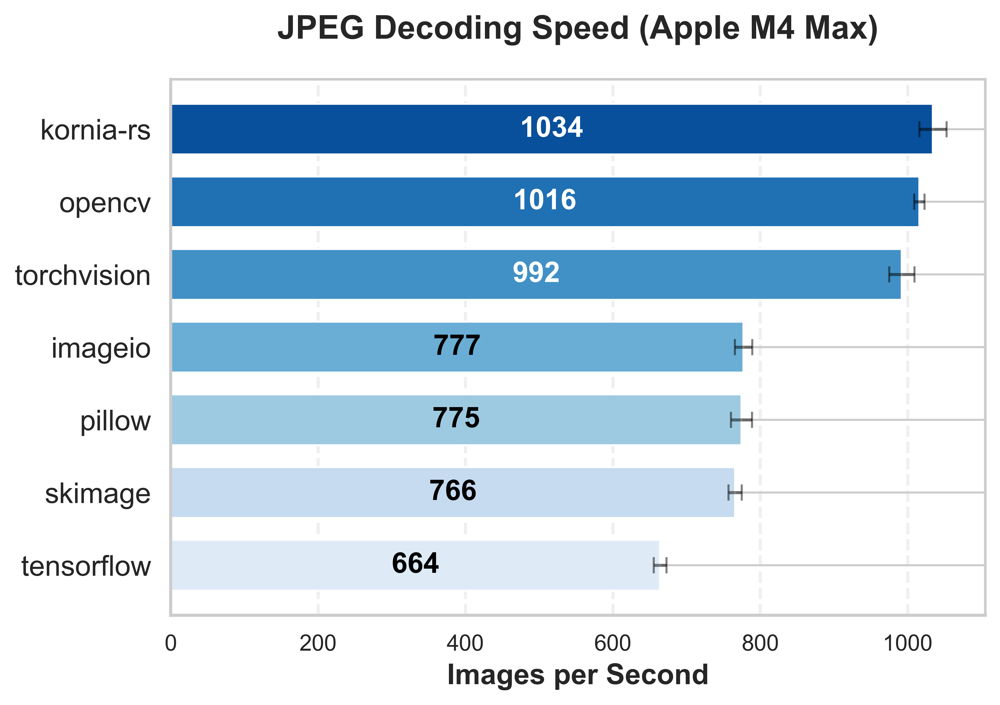

In [7]:
Image("jpeg_decoding.png", width="80%")

### 5. Избегать конфликтов многопроцессорности (OpenCV & PyTorch)

При использовании DataLoader с num_workers > 0 OpenCV по умолчанию может порождать свои потоки, что приводит к соперничеству за CPU и общему снижению скорости. Это часто происходит потому, что OpenCV (**cv2**) - бэкэнд для многих преобразований Albumentations, поэтому OpenCV может попытаться распараллелить свои собственные операции с использованием нескольких потоков.

- **Решение**: нужно заставить OpenCV работать в однопоточном режиме в каждом рабочем процессе. Для этого следует добавить этот код в начало обучающего скрипта:

```python
import cv2
cv2.setNumThreads(0)
# cv2.ocl.setUseOpenCL(False)
```

- Настройка **cv2.setNumThreads(0)** не позволяет OpenCV создавать собственный пул потоков в каждом рабочем процессе, что позволяет многопроцессорной обработке PyTorch эффективно управлять параллелизмом.

# Метрика mean average precision (mAP)

**[Хорошее объяснение](https://www.youtube.com/watch?v=LWiiHqI4Bg8&t=3273s&ab_channel=%D0%95%D0%B2%D0%B3%D0%B5%D0%BD%D0%B8%D0%B9%D0%A0%D0%B0%D0%B7%D0%B8%D0%BD%D0%BA%D0%BE%D0%B2)**

Метрика качества Mean Average Precision – это ключевая метрика для оценки качества моделей обнаружения объектов на изображении. Она позволяет численно оценить, насколько хорошо модель находит и правильно классифицирует объекты на изображении. 

**IoU** – показатель, который определяет, насколько хорошо совпадают 2 ограничивающих прямоугольника. Во время обучения нейросети у нас есть истинные и предсказанные ограничивающие прямоугольники и для них нужно определить, насколько хорошо предсказанные рамки совпадают с истинными. **IoU** вычисляется как площадь пересечения двух рамок, деленная на площадь их объединения. Значения **IoU** находятся в диапазоне от 0 до 1.

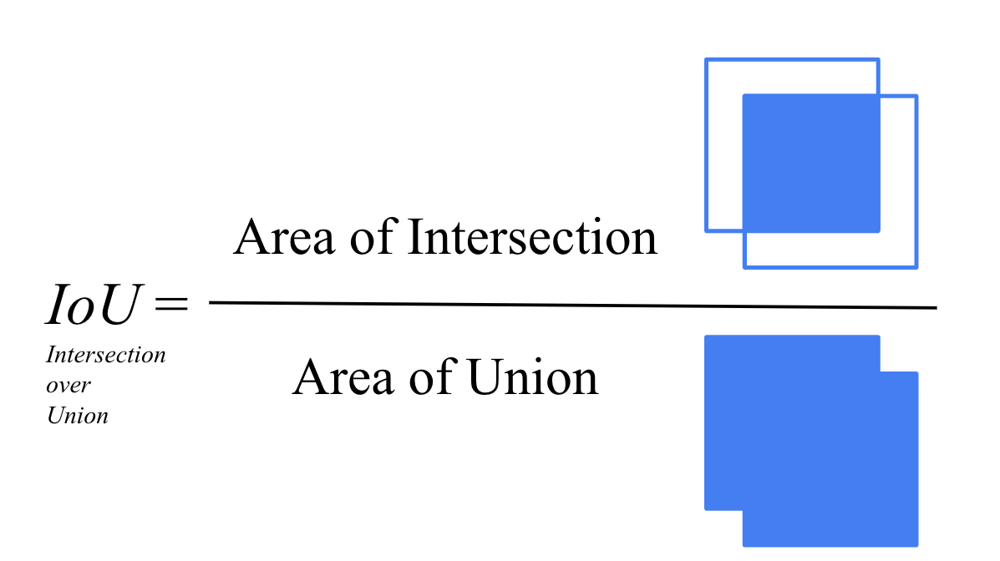

In [5]:
Image("IoU.png", width="60%")

Чтобы понять принцип работы **Mean Average Precision**, нужно сначала разобраться с показателями **Intersection over Union** (**IoU**), **True Positive**, **False Positive**, **False Negative** и метриками **Precision**, **Recall**.

**True Positive** (**TP**) – ситуация, когда модель правильно обнаружила объект определенного класса. Считается, что модель правильно обнаружила объект, если:
- Предсказанный ограничивающий прямоугольник имеет правильный класс. $\newline$
- Показатель **IoU** между предсказанным и соответствующим истинным ограничивающим прямоугольником больше или равно некоторого заданного порога. $\newline$
- Этот истинный ограничивающий прямоугольник еще не был обнаружен, так как одна истинная рамка может соответствовать только одному **True Positive**. $\newline$

**False Positive** (**FP**) – ситуация, когда модель обнаружила ограничивающий прямоугольник, которого нет на самом деле, или обнаружила неправильно. Это происходит, если:
- Предсказанный ограничивающий прямоугольник не соответствует ни одному истинному. $\newline$
- Предсказанный ограничивающий прямоугольник соответствует истинной рамке, но **IoU** меньше заданного порога. $\newline$
- Предсказанный ограничивающий прямоугольник имеет неправильный класс. $\newline$
- Несколько предсказанных ограничивающих прямоугольников соответствуют одному и тому же истинному ограничивающему прямоугольнику. В этом случае одна засчитывается как **True Positive**, а другая как **False Positive**. $\newline$

**False Negative** (**FN**) – ситуация, когда модель не предсказала ограничивающий прямоугольник, хотя он присутствует на изображении.

---

Дальнейшие метрики вычисляются для определенного порога уверенности модели. Модель на выходе выдает множество ограничивающих прямоугольников с разной уверенностью. При каждом уникальном пороге уверенности рассматриваются только те ограничивающие прямоугольники, уверенность которых выше порога.

**Precision** (точность) – метрика, которая показывает долю правильно обнаруженных ограничивающих прямоугольников среди всех предсказанных. 

$$Precision=\frac{TP}{TP+FP};$$

Высокий **Precision** означает, что среди предсказаний модели мало ложных предсказаний. Значения находятся в диапазоне от 0 до 1.

**Recall** (полнота) – метрика, которая показывает долю правильно обнаруженных ограничивающих прямоугольников среди всех истинных ограничивающих прямоугольников. 

$$Recall=\frac{TP}{TP+FN};$$

Высокий **Recall** означает, что модель нашла большинство реальных объектов на изображении. Значения находятся в диапазоне от 0 до 1.

Обе метрики очень важны, поэтому часто стоит задача максимизировать их, но проблема в том, что **Precision** и **Recall** сильно зависят от порога уверенности, который выбирается для моделей обнаружения объектов на изображении. При снижении порога уверенности обычно увеличивается **Recall**, но снижается **Precision**. При повышении порога уверенности растет **Precision**, а **Recall** снижается. Для решения этой проблемы можно использовать **Precision-Recall** кривую, которая призвана найти компромисс между точностью и полнотой. 

---

**Average Precision** (**AP**) – метрика, которая вычисляется как площадь под **Precision-Recall** кривой для конкретного класса. Чем больше эта площадь, тем лучше работает модель для конкретного класса, то есть лучше баланс между точностью и полнотой. Площадь под кривой считается с помощью интерполяции в 11 точках **Recall** или с помощью точного вычисления площади под ступенчатой кривой.

**Mean Average Precision** (**mAP**) – метрика, которая считается как среднее между всеми **Average Precision** для всех классов.

$$mAP=\frac{1}{N}\sum_{i=1}^{N}{AP}_i;$$

где N – количество классов.

Важно понимать, что метрика **Mean Average Precision** зависит от порога **IoU**, который выбирается заранее. Чтобы исключить эту зависимость, часто считают метрику **Mean Average Precision** (**mAP@[.5:.95]**), которая усреднена по всем порогам **IoU** от 0.5 до 0.95 с шагом 0.05. Такая метрика более строго оценивает точность локализации объектов на изображении. 

---

Алгоритм для одного изображения и одного класса:

1. **Фильтрация и сортировка предсказаний:**

    - Берем только те предсказанные рамки, класс которых совпадает с нашим целевым классом. $\newline$

    - Сортируем эти предсказанные рамки в порядке убывания оценки уверенности модели (от самой уверенной до наименее уверенной).$\newline$ 
    
    - Также мы работает только с истинными рамками целевого класса, все остальные объекты других классов на изображении полностью игнорируются. $\newline$
    
2. **Инициализация:**

    - Создаем список (или флаги) для всех истинных рамок на этом изображении, отмечая каждую как "несопоставленная". $\newline$

    - Обнуляем счетчики **TP**, **FP**, **FN**. $\newline$
    
3. **Перебор предсказанных рамок (начиная с самой уверенной):**

    - Идем по предсказанным рамкам из отсортированного списка (из шага 1) одну за другой. $\newline$
    
    - Переход от одного предсказанного бокса к следующему можно назвать одним шагом. После каждого шага происходит обновление кумулятивных (накопленных) счетчики `TP`, `FP` и пересчитываются `Precision` и `Recall`. Полученные значения `Precision` и `Recall` сохраняются для каждого шага, чтобы в конце посчитать площадь под полученной кривой.$\newline$
    
4. **Для текущей предсказанной рамки:**

    - Вычисляем **IoU** между этой предсказанной рамкой и **каждой** истинной рамкой на изображении (смотрим на все истинные боксы вне зависимости от того, сопоставлен он или нет). $\newline$

    - Находим истинную рамку, у которой наибольшее значение **IoU** с текущей предсказанной рамкой. $\newline$
    
5. **Принятие решения (TP или FP) для текущей предсказанной рамки:**

    - **Случай 1:** Максимальное **IoU** с найденной истинной рамкой **меньше** заданного порога **IoU** (например, < 0.5). $\newline$

        - Эта предсказанная рамка считается **ложно положительным** срабатыванием (**FP += 1**). Она не совпала ни с одной истинной рамкой достаточно хорошо. Переходим к следующей предсказанной рамке. $\newline$

    - **Случай 2:** Максимальное **IoU** с найденной истинной рамкой **больше** или **равно** заданному порогу **IoU** (например, >= 0.5). $\newline$

        - Мы нашли хорошее совпадение с истинной рамкой, которая еще не была "подобрана" более уверенным предсказанием. Эта предсказанная рамка считается **истинно положительным** срабатыванием (**TP += 1**). $\newline$

        - Мы помечаем эту истинную рамку как "сопоставленная", чтобы никакое другое предсказание (с меньшей уверенностью) больше не могло претендовать на нее. Переходим к следующей предсказанной рамке. $\newline$

    - **Случай 3:** (дополнение к Случаю 2): Что если предсказанная рамка хорошо совпала (IoU >= порога) с найденной истинной рамкой, которая уже была помечена как "сопоставленная" более уверенным предсказанием (с которым мы работали раньше в отсортированном списке)? $\newline$

        - Эта предсказанная рамка считается **ложно положительным** срабатыванием (**FP += 1**). Мы уже засчитали **TP** для этой истинной рамки с более уверенным предсказанием. Это предсказание является дублирующим. Переходим к следующей предсказанной рамке. $\newline$
        
6. **Определение False Negatives (FN) после того как мы прошлись по всем истинным рамкам на изображении:**

    - **Данный шаг необязателен для подсчета метрики.** Так как $Recall=\frac{TP}{TP+FN}=\frac{TP}{общее \,число \,всех \,истинных \,рамок}$, а общее число всех истинных рамок это константа, поэтому нет необходимости считать **FN**. Финальное значение **FN** (число необнаруженных объектов) является полезной метрикой для общего анализа работы модели, но для построения PR-кривой оно избыточно.$\newline$

    - Считаем все истинные рамки, которые остались помечены как "несопоставленные". $\newline$

    - Каждая такая истинная рамка считается **ложно отрицательным** срабатыванием (**FN += 1**). Модель их пропустила.